In [1]:
%run functions.ipynb
#spark = get_spark()

Ready: 2023-07-29 15:13:58


In [2]:
bank_list = ['Банки',
'Банкоматы',
'Бюро кредитных историй',
'Инвестиционные компании',
'Ипотечное / жилищное кредитование',
'Кредитные потребительские кооперативы',
'Лизинговые услуги',
'Ломбарды',
'Микрофинансирование',
'Обмен валюты',
'Операции на фондовом рынке',
'Паевые инвестиционные фонды (ПИФы)',
'Продажа инвестиционных драгоценных металлов / бриллиантов',
'Системы денежных переводов',
'Услуги факторинга',
'Негосударственные пенсионные фонды',
'Сельскохозяйственные кредитные потребительские кооперативы',
'Банковское оборудование',
'Ремонт банковского оборудования',
]

In [3]:
bank_list_lower = [i.lower() for i in bank_list]

In [3]:
bank_cond = '("' + '", "'.join(bank_list) + '")'

In [ ]:
bank_requests = spark.sql(f'''

select 
    f.rubricName
    ,f.time
    ,f.date
    ,f.tx
from final_df as f
where f.rubricName in {bank_cond}
''')

bank_requests.write.mode('overwrite').parquet(f'files/bank_requests')

# Москва матрицы

## Бизнес

In [4]:
city = 'Москва'
df_all = pd.read_parquet(f'files/ten_city/df_dates_users_city_agg2')
df_all = df_all[df_all['city'] == city]
df_all['city_rubric'] = df_all['city'] + '. ' + df_all['rubric']
df_all = df_all[~df_all.rubric.apply(lambda x: (x is None or x.isnumeric()))]
df_all['cnt_all'] = df_all.groupby('city_rubric')['cnt_requests'].transform(np.sum)
df_all = df_all.drop(['date_r', 'cnt_requests', 'cnt_users'], axis=1).drop_duplicates()
df_all = df_all.sort_values(['cnt_all'], ascending=False).reset_index().reset_index().set_index('level_0').drop('index', axis=1)
df_all['cnt_city_rubric'] = df_all['cnt_all'].astype(str) + '_' + df_all['city_rubric'] + '. ' + 'Запросы'
df_requests = df_all.copy()

df_all = pd.read_parquet(f'files/ten_city/df_dates_users_city_agg2')
df_all = df_all[df_all['city'] == city]
df_all['city_rubric'] = df_all['city'] + '. ' + df_all['rubric']
df_all = df_all[~df_all.rubric.apply(lambda x: (x is None or x.isnumeric()))]
df_all['cnt_all'] = df_all.groupby('city_rubric')['cnt_users'].transform(np.sum)
df_all = df_all.drop(['date_r', 'cnt_requests', 'cnt_users'], axis=1).drop_duplicates()
df_all = df_all.sort_values(['cnt_all'], ascending=False).reset_index().reset_index().set_index('level_0').drop('index', axis=1)
df_all['cnt_city_rubric'] = df_all['cnt_all'].astype(str) + '_' + df_all['city_rubric'] + '. ' + 'Пользователи'
df_users = df_all.copy()

df_100 = pd.concat([df_requests, df_users]).iloc[:30]

df1 = pd.read_parquet(f'files/ten_city/df_dates_users_city_agg2')
df1 = df1[df1['city'] == city]
df1['city_rubric_param'] = df1['city'] + '. ' + df1['rubric'] + '. ' + 'Пользователи'
df1 = df1[['date_r', 'cnt_users', 'city_rubric_param']].rename({'cnt_users':'cnt'}, axis=1)

df2 = pd.read_parquet(f'files/ten_city/df_dates_users_city_agg2')
df2 = df2[df2['city'] == city]
df2['city_rubric_param'] = df2['city'] + '. ' + df2['rubric'] + '. ' + 'Запросы'
df2 = df2[['date_r', 'cnt_requests', 'city_rubric_param']].rename({'cnt_requests':'cnt'}, axis=1)
df_dates_users = pd.concat([df1, df2])

df_dates_users['cnt_all'] = df_dates_users.groupby('city_rubric_param')['cnt'].transform(np.sum)
df_dates_users['city_rubric_param_cnt'] = df_dates_users['cnt_all'].astype(str) + '_' + df_dates_users['city_rubric_param']

dfx = pd.pivot_table(df_dates_users, values='cnt', aggfunc='sum', index=['date_r'], columns=['city_rubric_param_cnt'])
t_h = dfx.corr().fillna(0).astype(np.float16)

t = t_h.rename_axis([None]).rename_axis([None], axis=1)
t1 = t.stack()
t1 = t1.reset_index()
t1.columns = ['r1', 'r2', 'corr']
t1 = t1[t1.r1 != t1.r2]

t1_100 = df_100.merge(t1, left_on='cnt_city_rubric', right_on='r1')

t1_100['r1_cnt'] = t1_100.r1.apply(lambda x: x.split('_')[0])
t1_100['r2_cnt'] = t1_100.r2.apply(lambda x: x.split('_')[0])

t1_100.r1 = t1_100.r1.apply(lambda x: x.split('_')[1])
t1_100.r2 = t1_100.r2.apply(lambda x: x.split('_')[1])
t1_100['r1_city'] = t1_100.r1.apply(lambda x: x.split('. ')[0])
t1_100['r2_city'] = t1_100.r2.apply(lambda x: x.split('. ')[0])
t1_100['r1_rubric'] = t1_100.r1.apply(lambda x: x.split('. ')[1])
t1_100['r2_rubric'] = t1_100.r2.apply(lambda x: x.split('. ')[1])
t1_100['r1_param'] = t1_100.r1.apply(lambda x: x.split('. ')[2])
t1_100['r2_param'] = t1_100.r2.apply(lambda x: x.split('. ')[2])

t1_100.r1_cnt = t1_100.r1_cnt.astype(int)
t1_100.r2_cnt = t1_100.r2_cnt.astype(int)

t1_100 = t1_100[t1_100.r2_cnt > 1000]

t1_100 = t1_100[['r1', 'r2', 'r1_city', 'r1_rubric', 'r1_param', 'r2_city', 'r2_rubric', 'r2_param', 'corr', 'r1_cnt', 'r2_cnt']]

df_100.shape, t1_100.shape

t2 = t1_100[(t1_100.r1_cnt > 10000) & (t1_100.r2_cnt > 10000)]
t2['cnt_diff'] = abs(t2.r1_cnt - t2.r2_cnt)
t1_m = t2[t2['corr'] < 0].sort_values(['cnt_diff', 'r1_cnt'], ascending=[True, False])
fpath = Path(mpl.get_data_path(), r"C:\Users\Mamed\YandexDisk\_Documents\Проекты\2ГИС 2023\Лого\arialnarrow.ttf")
size_x=17.5 / 2.54 * 4
size_y=10.8   / 2.54 * 4

In [125]:
t1_m = t2[t2['corr'] < 0].sort_values(['cnt_diff', 'r1_cnt'], ascending=[True, False])

In [21]:
t1_bank = t1_100[t1_100.r1_rubric.apply(lambda x: x.lower() in bank_list_lower) | t1_100.r2_rubric.apply(lambda x: x.lower() in bank_list_lower)]

In [22]:
t1_bank.shape

(2818, 11)

In [127]:
t1_m = t1_bank

In [82]:
[i.lower().strip() for i in dfx.columns if i.lower().strip() in bank_list_lower]

['банки',
 'банковское оборудование',
 'банкоматы',
 'бюро кредитных историй',
 'инвестиционные компании',
 'кредитные потребительские кооперативы',
 'лизинговые услуги',
 'микрофинансирование',
 'негосударственные пенсионные фонды',
 'обмен валюты',
 'операции на фондовом рынке',
 'паевые инвестиционные фонды (пифы)',
 'ремонт банковского оборудования',
 'системы денежных переводов',
 'услуги факторинга']

In [94]:
bank_list_lower

['банки',
 'банкоматы',
 'бюро кредитных историй',
 'инвестиционные компании',
 'ипотечное / жилищное кредитование',
 'кредитные потребительские кооперативы',
 'лизинговые услуги',
 'ломбарды',
 'микрофинансирование',
 'обмен валюты',
 'операции на фондовом рынке',
 'паевые инвестиционные фонды (пифы)',
 'продажа инвестиционных драгоценных металлов / бриллиантов',
 'системы денежных переводов',
 'услуги факторинга',
 'негосударственные пенсионные фонды',
 'сельскохозяйственные кредитные потребительские кооперативы',
 'банковское оборудование',
 'ремонт банковского оборудования']

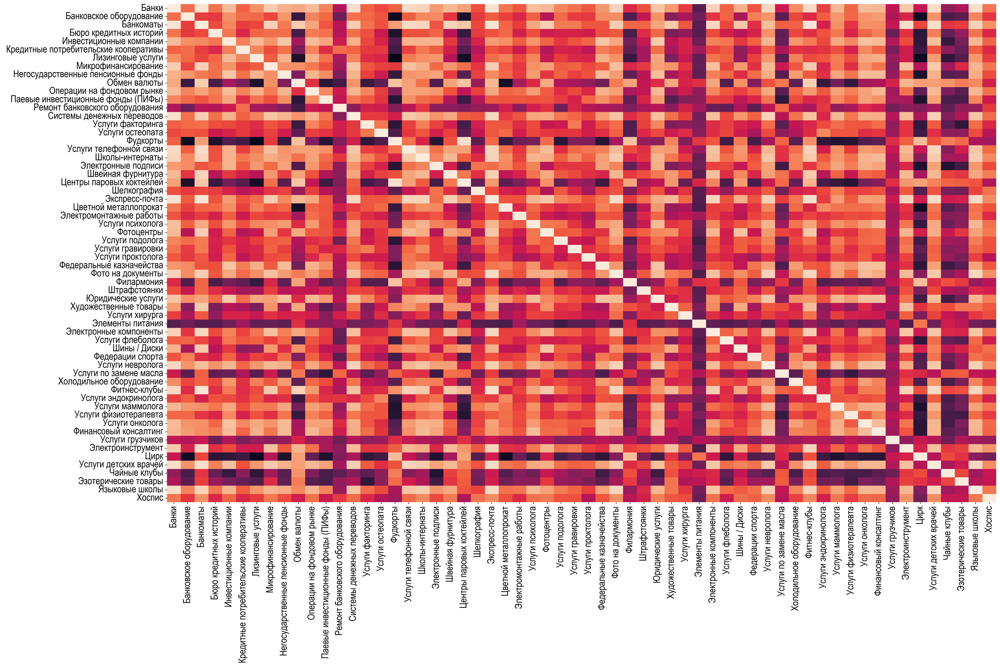

In [108]:
negative_corr = t1_m.iloc[:500]
negative_corr_rubrics = pd.concat([negative_corr.r1, negative_corr.r2]).drop_duplicates().values
negative_corr_rubrics = [i.split('. ')[1] for i in negative_corr_rubrics]

df_dates_negative = df_dates_users[df_dates_users['city_rubric_param'].apply(lambda x: ((x.split('. ')[1].lower() in bank_list_lower) 
                                                                                        | (x.split('. ')[1].lower() in [i.lower() for i in negative_corr_rubrics[:]]  and (len(x.split('. ')[1]) < 25))))]
df_dates_negative['rubric'] = df_dates_negative['city_rubric_param'].apply(lambda x: x.split('.')[1])
dfx = pd.pivot_table(df_dates_negative, values='cnt', aggfunc='sum', index=['date_r'], columns=['rubric'])[
    sorted(dfx.columns, key = lambda x: '0' if x.lower().strip() in bank_list_lower else str(random.randint(1, 100)))
].iloc[:,:60]
t_h = dfx.corr().fillna(0)

fig, ax = plt.subplots()
ax = sns.heatmap(t_h, annot=False, cbar=False)
plt.xticks(font=fpath, fontsize=18)
plt.yticks(font=fpath, fontsize=18)
plt.rcParams['figure.dpi'] = 2**8
plt.rcParams['figure.figsize']=size_x,size_y
ax.set_xlabel('')
ax.set_ylabel('')

fig.savefig(f'corr_matrix.png', bbox_inches='tight', transparent=False, facecolor='white')
#plt.show()

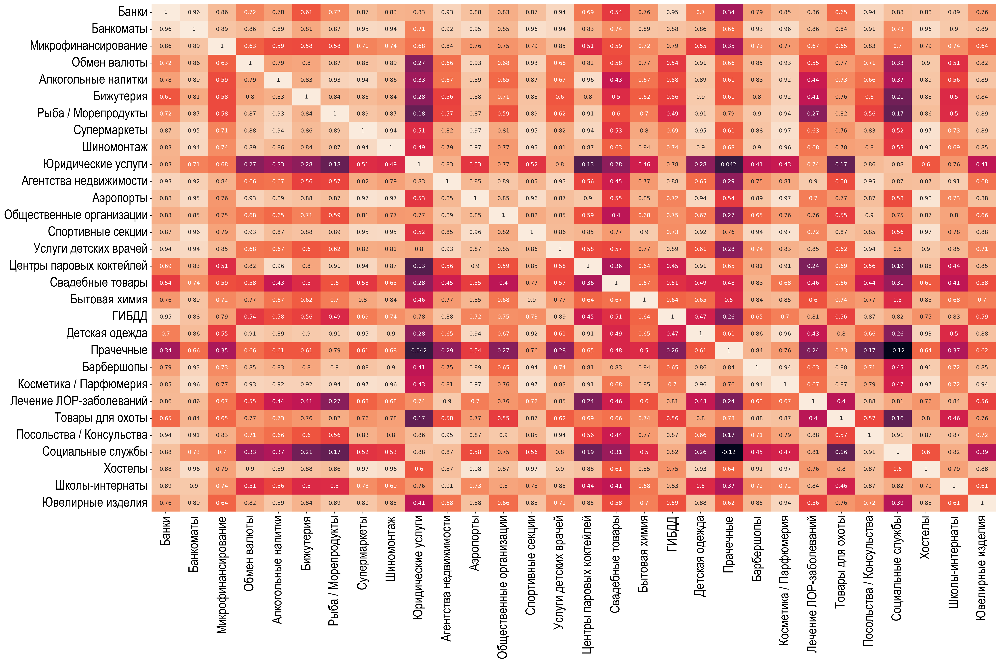

In [114]:
df_dates_all = df_dates_users
df_dates_all['city_rubric'] = df_dates_all['city_rubric_param']
df_dates_all['rubric'] = df_dates_all['city_rubric_param'].apply(lambda x: x.split('. ')[1])

positive_corr = t2[t2['corr'] >= 0.50]
positive_corr_rubrics = pd.concat([positive_corr.r1, positive_corr.r2]).drop_duplicates().values
positive_corr_rubrics = [i.split('. ')[1] for i in positive_corr_rubrics]

df_dates_positive = df_dates_all[df_dates_all['rubric'].apply(lambda x: ((x in positive_corr_rubrics) and (len(x) < 25)))]

dfx = pd.pivot_table(df_dates_positive, values='cnt', aggfunc='sum', index=['date_r'], columns=['rubric'])
dfx = dfx[
    sorted(dfx.columns, key = lambda x: '0' if x.lower().strip() in bank_list_lower else str(random.randint(1, 100)))
].iloc[:,:30]


t_h = dfx.corr().fillna(0)

fig, ax = plt.subplots()
ax = sns.heatmap(t_h, annot=True, cbar=False)
plt.xticks(font=fpath, fontsize=24)
plt.yticks(font=fpath, fontsize=24)
plt.rcParams['figure.dpi'] = 2**8
plt.rcParams['figure.figsize']=size_x,size_y
ax.set_xlabel('')
ax.set_ylabel('')

fig.savefig(f'corr_matrix_1.png', bbox_inches='tight', transparent=False)
#plt.show()

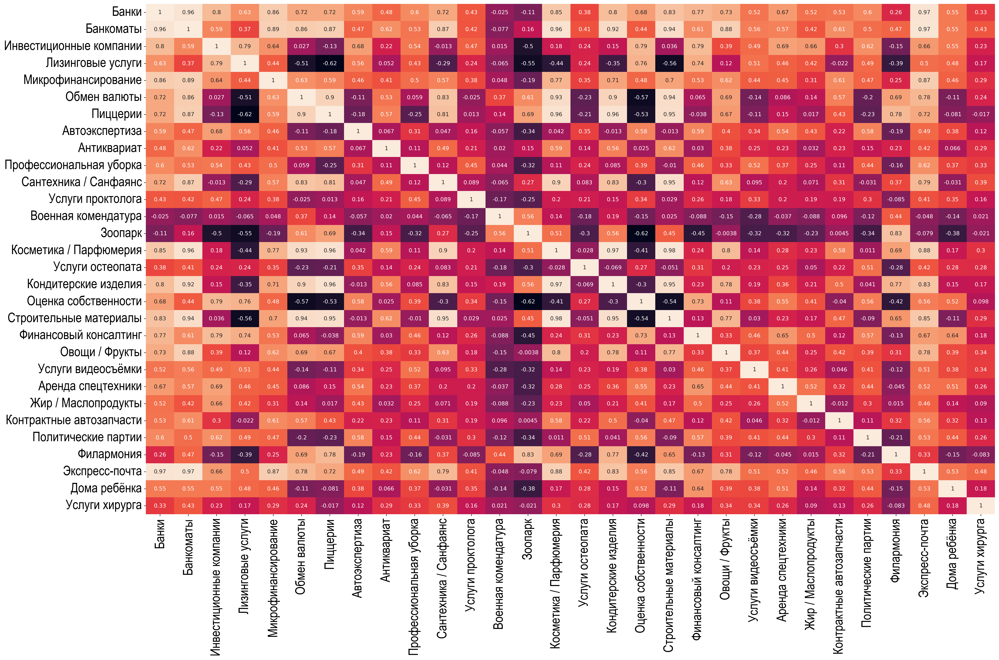

In [115]:
negative_corr = t1_m.iloc[:500]
negative_corr_rubrics = pd.concat([negative_corr.r1, negative_corr.r2]).drop_duplicates().values
negative_corr_rubrics = [i.split('. ')[1] for i in negative_corr_rubrics]

df_dates_negative = df_dates_all[df_dates_all['rubric'].apply(lambda x: (x in negative_corr_rubrics[:500]) and (len(x) < 25))]

dfx = pd.pivot_table(df_dates_negative, values='cnt', aggfunc='sum', index=['date_r'], columns=['rubric'])
dfx = dfx[
    sorted(dfx.columns, key = lambda x: '0' if x.lower().strip() in bank_list_lower else str(random.randint(1, 100)))
].iloc[:,:30]

t_h = dfx.corr().fillna(0)

fig, ax = plt.subplots()
ax = sns.heatmap(t_h, annot=True, cbar=False)
plt.xticks(font=fpath, fontsize=24)
plt.yticks(font=fpath, fontsize=24)
plt.rcParams['figure.dpi'] = 2**8
plt.rcParams['figure.figsize']=size_x,size_y
ax.set_xlabel('')
ax.set_ylabel('')

fig.savefig(f'corr_matrix_2.png', bbox_inches='tight', transparent=False)
plt.show()

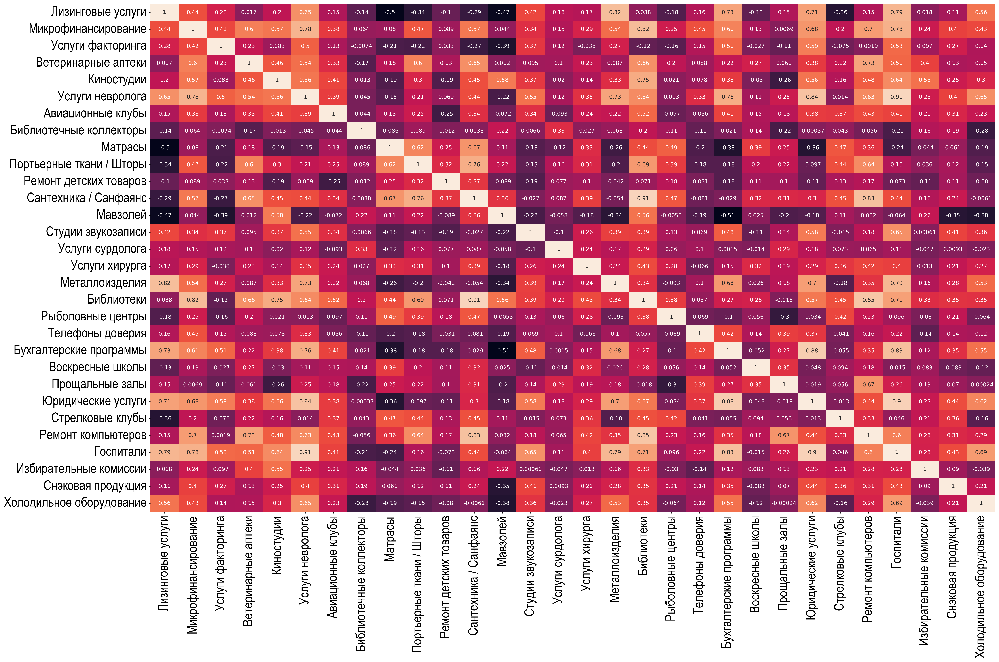

In [117]:
zero_corr = t1[t1['corr'] < abs(0.41)]
zero_corr_rubrics = pd.concat([zero_corr.r1, zero_corr.r2]).drop_duplicates().values
zero_corr_rubrics = [i.split('. ')[1] for i in zero_corr_rubrics]

df_dates_zero = df_dates_all[df_dates_all['rubric'].apply(lambda x: (x in zero_corr_rubrics[:500]) and (len(x) < 25) )]

dfx = pd.pivot_table(df_dates_zero, values='cnt', aggfunc='sum', index=['date_r'], columns=['rubric'])
dfx = dfx[
    sorted(dfx.columns, key = lambda x: '0' if x.lower().strip() in bank_list_lower else str(random.randint(1, 100)))
].iloc[:,:30]
t_h = dfx.corr().fillna(0)

fig, ax = plt.subplots()
ax = sns.heatmap(t_h, annot=True, cbar=False)
plt.xticks(font=fpath, fontsize=24)
plt.yticks(font=fpath, fontsize=24)
plt.rcParams['figure.dpi'] = 2**8
plt.rcParams['figure.figsize']=size_x,size_y
ax.set_xlabel('')
ax.set_ylabel('')

fig.savefig(f'corr_matrix_3.png', bbox_inches='tight', transparent=False)
plt.show()

## Бизнес - город

In [20]:
df_all = pd.concat([pd.read_parquet(f'files/ten_city/df_dates_{col_r}').rename({col_r: 'date_r'}, axis=1)[['rubricName', 'date_r', 'cnt', 'city', 'year_r']] for col_r in ['hour_r', 'date_r', 'week_r', 'week_day_r']])
rs = "('" + "','".join(list(df_all.rubricName.dropna().unique())) + "')"

df_schema = StructType([StructField('user', StringType(), True), StructField('proj', StringType(), True), StructField('rubricName', StringType(), True), StructField('rubricID', IntegerType(), True), StructField('time', StringType(), True), StructField('date', StringType(), True), StructField('org', StringType(), True), StructField('branch', StringType(), True), StructField('prod', StringType(), True), StructField('tx', StringType(), True), StructField('fl', StringType(), True), StructField('devmod', StringType(), True), StructField('lat', StringType(), True), StructField('lon', StringType(), True)])
df_list = [i for i in files_list_chain]

In [ ]:
for file in tqdm(df_list[:4]):
    df = spark.read.option("header","true").csv(file, schema=df_schema)
    df.createOrReplaceTempView('df')
    city = file.split('\\')[2]
    df_new = spark.sql(f'''
    select 
        rubricName as rubric
        , "{city}" city
        , user
        , SUBSTR(time, 6, 5) date_r
        from df
    ''').where(f'rubric in {rs}')

    df_new.write.partitionBy('rubric').mode('append').parquet(f'files/ten_city/df_dates_users_city2')

  0%|          | 0/4 [00:00<?, ?it/s]

In [2]:
df_all = pd.concat([pd.read_parquet(f'files/ten_city/df_dates_{col_r}').rename({col_r: 'date_r'}, axis=1)[['rubricName', 'date_r', 'cnt', 'city', 'year_r']] for col_r in ['hour_r', 'date_r', 'week_r', 'week_day_r']])
df_all['city_rubric'] = df_all['city'] + '. ' + df_all['rubricName']
df_all = df_all[~df_all.rubricName.apply(lambda x: (x is None or x.isnumeric()))]
rubrics = df_all.rubricName.unique()

for rubric in tqdm(rubrics[910:]):
    try:
        df = spark.read.parquet(fr"C:\Users\Mamed\_Notebooks\2GIS_2023\files\ten_city\df_dates_users_city2\rubric={rubric.replace(' ', '%20').replace('/','%2F')}")
        df.createOrReplaceTempView('df')
        df_new = spark.sql(f'''
        select 
            "{rubric}" rubric
            ,city
            , date_r
            ,count(distinct user) cnt_users
            ,count(*) cnt_requests
        from df
            group by 
                    "{rubric}"
                    ,city
                    ,date_r

        ''')
        df_new.write.mode('append').parquet(f'files/ten_city/df_dates_users_city_agg2')
    except:
        pass

  0%|          | 0/731 [00:00<?, ?it/s]

In [2]:
#city = 'Москва'
df_all = pd.read_parquet(f'files/ten_city/df_dates_users_city_agg2')
#df_all = df_all[df_all['city'] == city]
df_all['city_rubric'] = df_all['city'] + '. ' + df_all['rubric']
df_all = df_all[~df_all.rubric.apply(lambda x: (x is None or x.isnumeric()))]
df_all['cnt_all'] = df_all.groupby('city_rubric')['cnt_requests'].transform(np.sum)
df_all = df_all.drop(['date_r', 'cnt_requests', 'cnt_users'], axis=1).drop_duplicates()
df_all = df_all.sort_values(['cnt_all'], ascending=False).reset_index().reset_index().set_index('level_0').drop('index', axis=1)
df_all['cnt_city_rubric'] = df_all['cnt_all'].astype(str) + '_' + df_all['city_rubric'] + '. ' + 'Запросы'
df_requests = df_all.copy()

df_all = pd.read_parquet(f'files/ten_city/df_dates_users_city_agg2')
#df_all = df_all[df_all['city'] == city]
df_all['city_rubric'] = df_all['city'] + '. ' + df_all['rubric']
df_all = df_all[~df_all.rubric.apply(lambda x: (x is None or x.isnumeric()))]
df_all['cnt_all'] = df_all.groupby('city_rubric')['cnt_users'].transform(np.sum)
df_all = df_all.drop(['date_r', 'cnt_requests', 'cnt_users'], axis=1).drop_duplicates()
df_all = df_all.sort_values(['cnt_all'], ascending=False).reset_index().reset_index().set_index('level_0').drop('index', axis=1)
df_all['cnt_city_rubric'] = df_all['cnt_all'].astype(str) + '_' + df_all['city_rubric'] + '. ' + 'Пользователи'
df_users = df_all.copy()

df_100 = pd.concat([df_requests, df_users]).iloc[:30]

df1 = pd.read_parquet(f'files/ten_city/df_dates_users_city_agg2')
#df1 = df1[df1['city'] == city]

df1['city_rubric_param'] = df1['city'] + '. ' + df1['rubric'] + '. ' + 'Пользователи'
df1 = df1[['date_r', 'cnt_users', 'city_rubric_param']].rename({'cnt_users':'cnt'}, axis=1)

df2 = pd.read_parquet(f'files/ten_city/df_dates_users_city_agg2')
#df2 = df2[df2['city'] == city]

df2['city_rubric_param'] = df2['city'] + '. ' + df2['rubric'] + '. ' + 'Запросы'
df2 = df2[['date_r', 'cnt_requests', 'city_rubric_param']].rename({'cnt_requests':'cnt'}, axis=1)
df_dates_users = pd.concat([df1, df2])

df_dates_users['cnt_all'] = df_dates_users.groupby('city_rubric_param')['cnt'].transform(np.sum)
df_dates_users['city_rubric_param_cnt'] = df_dates_users['cnt_all'].astype(str) + '_' + df_dates_users['city_rubric_param']
df_dates_users['city_rubric'] = df_dates_users['city_rubric_param'].apply(lambda x: x.split('. ')[0] + '. ' + x.split('. ')[1])

dfx = pd.pivot_table(df_dates_users, values='cnt', aggfunc='sum', index=['date_r'], columns=['city_rubric_param_cnt'])

In [14]:
%%time
t_h = dfx.corr().fillna(0).astype(np.float16)

CPU times: total: 2min 28s
Wall time: 2min 48s


In [15]:
t = t_h

In [16]:
%%time
t = t.rename_axis([None]).rename_axis([None], axis=1)
t1 = t.stack()
t1 = t1.reset_index()
t1.columns = ['r1', 'r2', 'corr']
t1 = t1[t1.r1 != t1.r2]

CPU times: total: 3min 18s
Wall time: 3min 54s


In [17]:
%%time
t1_100 = df_100.merge(t1, left_on='cnt_city_rubric', right_on='r1')

CPU times: total: 1min 2s
Wall time: 1min 23s


In [18]:
t1_100['r1_cnt'] = t1_100.r1.apply(lambda x: x.split('_')[0])
t1_100['r2_cnt'] = t1_100.r2.apply(lambda x: x.split('_')[0])

t1_100.r1 = t1_100.r1.apply(lambda x: x.split('_')[1])
t1_100.r2 = t1_100.r2.apply(lambda x: x.split('_')[1])
t1_100['r1_city'] = t1_100.r1.apply(lambda x: x.split('. ')[0])
t1_100['r2_city'] = t1_100.r2.apply(lambda x: x.split('. ')[0])
t1_100['r1_rubric'] = t1_100.r1.apply(lambda x: x.split('. ')[1])
t1_100['r2_rubric'] = t1_100.r2.apply(lambda x: x.split('. ')[1])
t1_100['r1_param'] = t1_100.r1.apply(lambda x: x.split('. ')[2])
t1_100['r2_param'] = t1_100.r2.apply(lambda x: x.split('. ')[2])

t1_100.r1_cnt = t1_100.r1_cnt.astype(int)
t1_100.r2_cnt = t1_100.r2_cnt.astype(int)

t1_100 = t1_100[t1_100.r2_cnt > 1000]

t1_100 = t1_100[['r1', 'r2', 'r1_city', 'r1_rubric', 'r1_param', 'r2_city', 'r2_rubric', 'r2_param', 'corr', 'r1_cnt', 'r2_cnt']]

df_100.shape, t1_100.shape

((30, 5), (379020, 11))

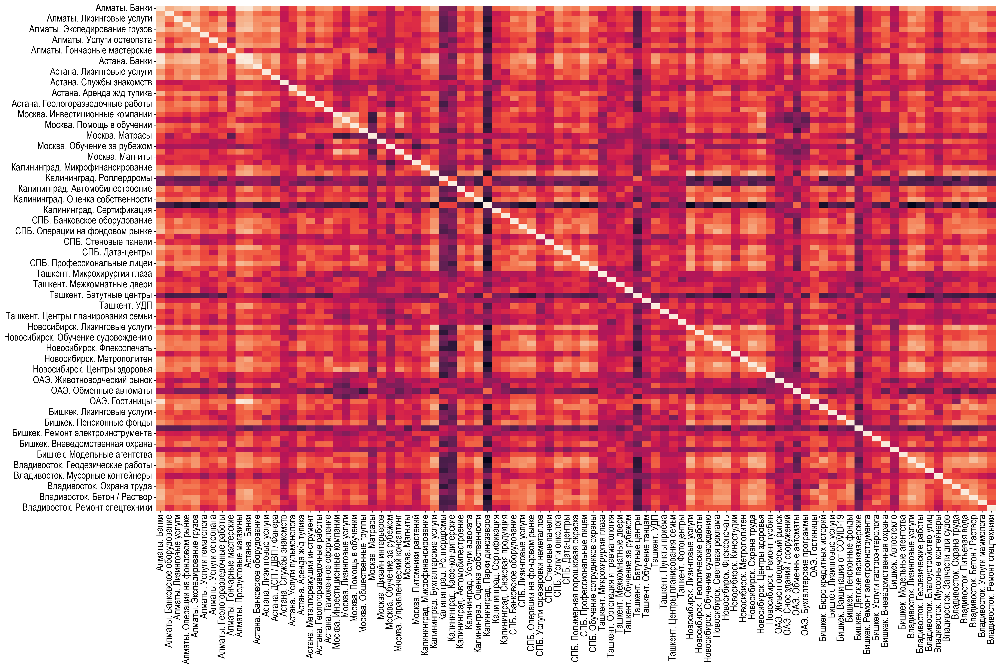

In [72]:
t2 = t1_100
t2['cnt_diff'] = abs(t2.r1_cnt - t2.r2_cnt)
t1_m = t2[t2['corr'] < 0].sort_values(['cnt_diff', 'r1_cnt'], ascending=[True, False])

negative_corr_rubrics = pd.concat([t1_m.r1, t1_m.r2]).drop_duplicates().values

df_dates_negative = df_dates_users[df_dates_users['city_rubric_param'].apply(lambda x: ((x in negative_corr_rubrics) and (len(x.replace('. Запросы','')) < 35)))]
df_dates_negative['city_rubric_param'] = df_dates_negative['city_rubric_param']
dfx_pred = pd.pivot_table(df_dates_negative, values='cnt', aggfunc='sum', index=['date_r'], columns=['city_rubric_param'])
dfx_pred = dfx_pred[
    sorted(dfx_pred.columns, key = lambda x: '0' if x.split('. ')[1].lower().strip() in bank_list_lower else str(random.randint(1, 100)))
].filter(regex='Запросы', axis=1)

cities = ['Алматы', 'Астана', 'Москва', 'Калининград', 'СПБ', 'Ташкент', 'Новосибирск', 'ОАЭ', 'Бишкек', 'Владивосток']
dfx = pd.concat([dfx_pred.filter(regex=f'{city}').iloc[:,:10] for city in cities], axis=1)
dfx.columns = [i.replace('. Запросы','') for i in dfx.columns]
t_h = dfx.corr().fillna(0)

fig, ax = plt.subplots()
ax = sns.heatmap(t_h, annot=False, cbar=False)
plt.xticks(font=fpath, fontsize=18)
plt.yticks(font=fpath, fontsize=18)
plt.rcParams['figure.dpi'] = 2**8
plt.rcParams['figure.figsize']=size_x,size_y
ax.set_xlabel('')
ax.set_ylabel('')

fig.savefig('corr_matrix_other.png', bbox_inches='tight', transparent=False, facecolor='white')
plt.show()

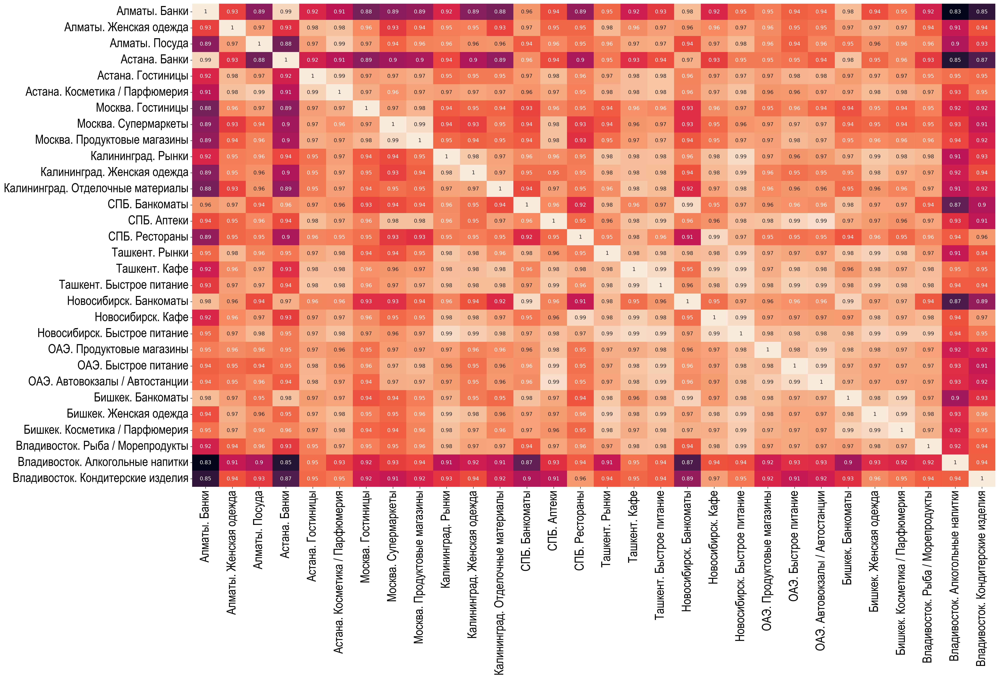

In [104]:
df_dates_all = df_dates_users
df_dates_all['city_rubric'] = df_dates_all['city_rubric_param']

positive_corr = t2[t2['corr'] >= 0.95]
positive_corr_rubrics = pd.concat([positive_corr.r1, positive_corr.r2]).drop_duplicates().values

df_dates_positive = df_dates_all[df_dates_all['city_rubric'].apply(lambda x: ((x in positive_corr_rubrics[:500]) and (len(x.replace('. Запросы','')) < 35)))]

dfx_pred = pd.pivot_table(df_dates_positive, values='cnt', aggfunc='sum', index=['date_r'], columns=['city_rubric'])
dfx_pred = dfx_pred[
    sorted(dfx_pred.columns, key = lambda x: '0' if x.split('. ')[1].lower().strip() in bank_list_lower else str(random.randint(1, 100)))
].filter(regex='Запросы', axis=1)

dfx_1 = dfx_pred[[ i for i in dfx_pred.columns if 'Запросы' in i and 'Алматы' in i]].iloc[:,:3]
dfx_2 = dfx_pred[[ i for i in dfx_pred.columns if 'Запросы' in i and 'Астана' in i]].iloc[:,:3]
dfx_3 = dfx_pred[[ i for i in dfx_pred.columns if 'Запросы' in i and 'Москва' in i]].iloc[:,:3]
dfx_4 = dfx_pred[[ i for i in dfx_pred.columns if 'Запросы' in i and 'Калининград' in i]].iloc[:,:3]
dfx_5 = dfx_pred[[ i for i in dfx_pred.columns if 'Запросы' in i and 'СПБ' in i]].iloc[:,:3]
dfx_6 = dfx_pred[[ i for i in dfx_pred.columns if 'Запросы' in i and 'Ташкент' in i]].iloc[:,:3]
dfx_7 = dfx_pred[[ i for i in dfx_pred.columns if 'Запросы' in i and 'Новосибирск' in i]].iloc[:,:3]
dfx_8 = dfx_pred[[ i for i in dfx_pred.columns if 'Запросы' in i and 'ОАЭ' in i]].iloc[:,:3]
dfx_9 = dfx_pred[[ i for i in dfx_pred.columns if 'Запросы' in i and 'Бишкек' in i]].iloc[:,:3]
dfx_10 = dfx_pred[[i for i in dfx_pred.columns if 'Запросы' in i and 'Владивосток' in i]].iloc[:,:3]

dfx = (dfx_1
.merge(dfx_2, left_index=True, right_index=True)
.merge(dfx_3, left_index=True, right_index=True)
.merge(dfx_4, left_index=True, right_index=True)
.merge(dfx_5, left_index=True, right_index=True)
.merge(dfx_6, left_index=True, right_index=True)
.merge(dfx_7, left_index=True, right_index=True)
.merge(dfx_8, left_index=True, right_index=True)
.merge(dfx_9, left_index=True, right_index=True)
.merge(dfx_10, left_index=True, right_index=True)
)
dfx.columns = [i.replace('. Запросы','') for i in dfx.columns]
t_h = dfx.corr().fillna(0)

fig, ax = plt.subplots()
ax = sns.heatmap(t_h, annot=True, cbar=False)
plt.xticks(font=fpath, fontsize=24)
plt.yticks(font=fpath, fontsize=24)
plt.rcParams['figure.dpi'] = 2**8
plt.rcParams['figure.figsize']=size_x,size_y
ax.set_xlabel('')
ax.set_ylabel('')

fig.savefig(f'corr_matrix_1_other.png', bbox_inches='tight', transparent=False, facecolor='white')
plt.show()

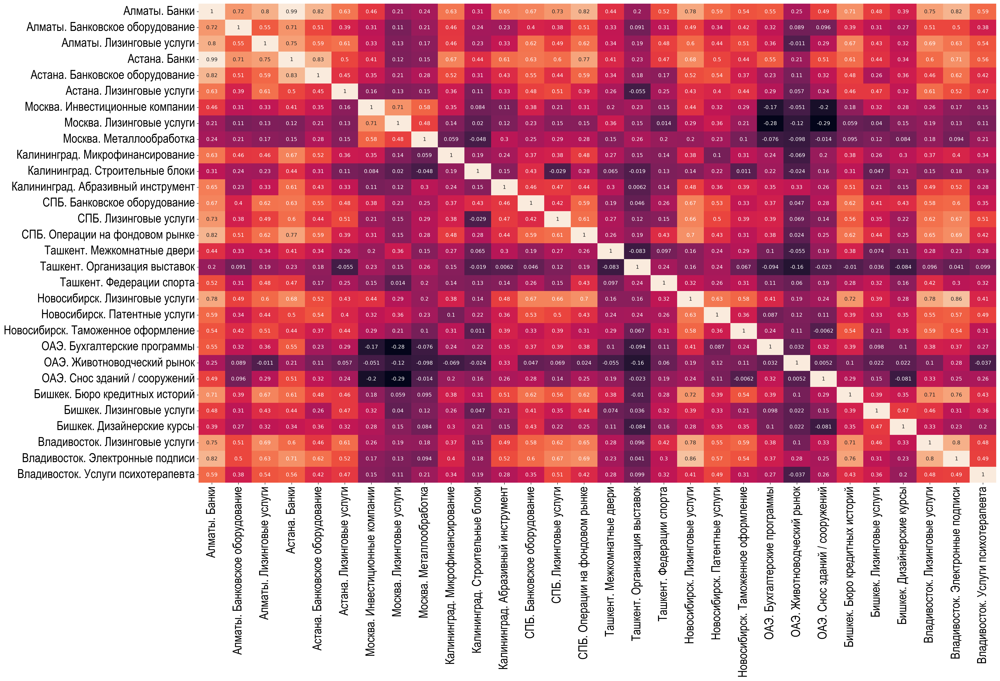

In [112]:
negative_corr = t1_m
negative_corr_rubrics = pd.concat([negative_corr.r1, negative_corr.r2]).drop_duplicates().values
#negative_corr_rubrics = [i.split('_')[1] for i in negative_corr_rubrics]

df_dates_negative = df_dates_all[df_dates_all['city_rubric'].apply(lambda x: (x in negative_corr_rubrics[:]) and (len(x.replace('. Запросы','')) < 35))]

dfx_pred = pd.pivot_table(df_dates_negative, values='cnt', aggfunc='sum', index=['date_r'], columns=['city_rubric'])
dfx_pred = dfx_pred[
    sorted(dfx_pred.columns, key = lambda x: '0' if x.split('. ')[1].lower().strip() in bank_list_lower else str(random.randint(1, 100)))
].filter(regex='Запросы', axis=1)

dfx_1 = dfx_pred[[ i for i in dfx_pred.columns if 'Запросы' in i and 'Алматы' in i]].iloc[:,:3]
dfx_2 = dfx_pred[[ i for i in dfx_pred.columns if 'Запросы' in i and 'Астана' in i]].iloc[:,:3]
dfx_3 = dfx_pred[[ i for i in dfx_pred.columns if 'Запросы' in i and 'Москва' in i]].iloc[:,:3]
dfx_4 = dfx_pred[[ i for i in dfx_pred.columns if 'Запросы' in i and 'Калининград' in i]].iloc[:,:3]
dfx_5 = dfx_pred[[ i for i in dfx_pred.columns if 'Запросы' in i and 'СПБ' in i]].iloc[:,:3]
dfx_6 = dfx_pred[[ i for i in dfx_pred.columns if 'Запросы' in i and 'Ташкент' in i]].iloc[:,:3]
dfx_7 = dfx_pred[[ i for i in dfx_pred.columns if 'Запросы' in i and 'Новосибирск' in i]].iloc[:,:3]
dfx_8 = dfx_pred[[ i for i in dfx_pred.columns if 'Запросы' in i and 'ОАЭ' in i]].iloc[:,:3]
dfx_9 = dfx_pred[[ i for i in dfx_pred.columns if 'Запросы' in i and 'Бишкек' in i]].iloc[:,:3]
dfx_10 = dfx_pred[[i for i in dfx_pred.columns if 'Запросы' in i and 'Владивосток' in i]].iloc[:,:3]

dfx = (dfx_1
.merge(dfx_2, left_index=True, right_index=True)
.merge(dfx_3, left_index=True, right_index=True)
.merge(dfx_4, left_index=True, right_index=True)
.merge(dfx_5, left_index=True, right_index=True)
.merge(dfx_6, left_index=True, right_index=True)
.merge(dfx_7, left_index=True, right_index=True)
.merge(dfx_8, left_index=True, right_index=True)
.merge(dfx_9, left_index=True, right_index=True)
.merge(dfx_10, left_index=True, right_index=True)
)
dfx.columns = [i.replace('. Запросы','') for i in dfx.columns]
t_h = dfx.corr().fillna(0)

fig, ax = plt.subplots()
ax = sns.heatmap(t_h, annot=True, cbar=False)
plt.xticks(font=fpath, fontsize=24)
plt.yticks(font=fpath, fontsize=24)
plt.rcParams['figure.dpi'] = 2**8
plt.rcParams['figure.figsize']=size_x,size_y
ax.set_xlabel('')
ax.set_ylabel('')

fig.savefig(f'corr_matrix_2_other.png', bbox_inches='tight', transparent=False, facecolor='white')
plt.show()

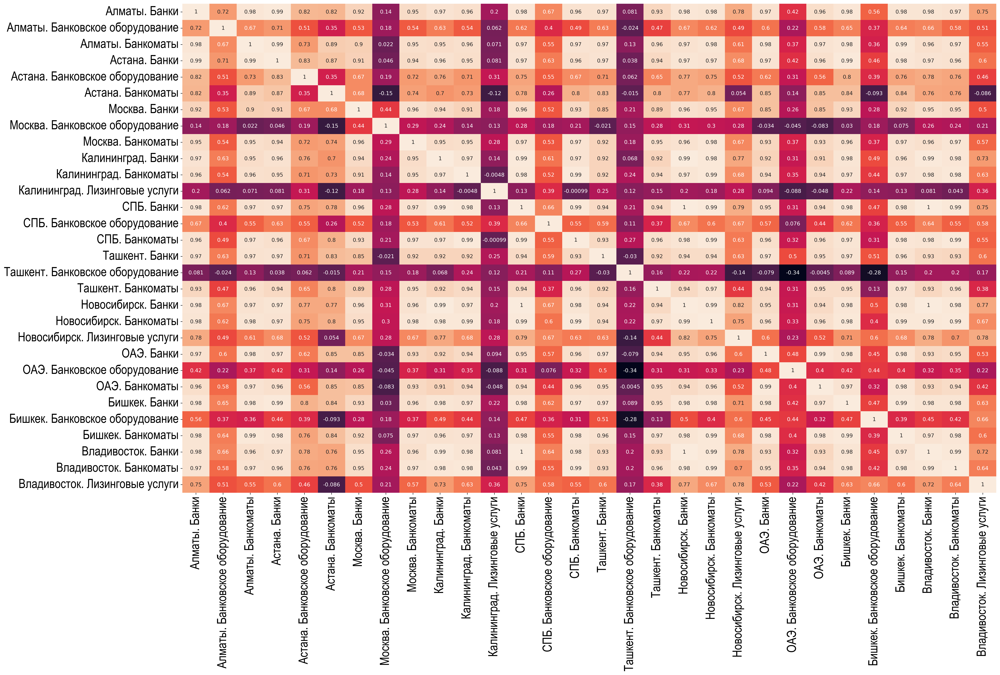

In [119]:
zero_corr = t1[t1['corr'] < abs(0.41)]
zero_corr_rubrics = pd.concat([zero_corr.r1, zero_corr.r2]).drop_duplicates().values
zero_corr_rubrics = [i.split('_')[1] for i in zero_corr_rubrics]
zero_corr_rubrics = sorted(zero_corr_rubrics, key = lambda x: '0' if x.split('. ')[1].lower().strip() in bank_list_lower else str(random.randint(1, 100)))

df_dates_zero = df_dates_all[df_dates_all['city_rubric'].apply(lambda x: (x in zero_corr_rubrics[:1000]) and (len(x.replace('. Запросы','')) < 35) )]

dfx_pred = pd.pivot_table(df_dates_zero, values='cnt', aggfunc='sum', index=['date_r'], columns=['city_rubric'])
dfx_pred = dfx_pred[
    sorted(dfx_pred.columns, key = lambda x: '0' if x.split('. ')[1].lower().strip() in bank_list_lower else str(random.randint(1, 100)))
].filter(regex='Запросы', axis=1)

dfx_1 = dfx_pred[[ i for i in dfx_pred.columns if 'Запросы' in i and 'Алматы' in i]].iloc[:,:3]
dfx_2 = dfx_pred[[ i for i in dfx_pred.columns if 'Запросы' in i and 'Астана' in i]].iloc[:,:3]
dfx_3 = dfx_pred[[ i for i in dfx_pred.columns if 'Запросы' in i and 'Москва' in i]].iloc[:,:3]
dfx_4 = dfx_pred[[ i for i in dfx_pred.columns if 'Запросы' in i and 'Калининград' in i]].iloc[:,:3]
dfx_5 = dfx_pred[[ i for i in dfx_pred.columns if 'Запросы' in i and 'СПБ' in i]].iloc[:,:3]
dfx_6 = dfx_pred[[ i for i in dfx_pred.columns if 'Запросы' in i and 'Ташкент' in i]].iloc[:,:3]
dfx_7 = dfx_pred[[ i for i in dfx_pred.columns if 'Запросы' in i and 'Новосибирск' in i]].iloc[:,:3]
dfx_8 = dfx_pred[[ i for i in dfx_pred.columns if 'Запросы' in i and 'ОАЭ' in i]].iloc[:,:3]
dfx_9 = dfx_pred[[ i for i in dfx_pred.columns if 'Запросы' in i and 'Бишкек' in i]].iloc[:,:3]
dfx_10 = dfx_pred[[i for i in dfx_pred.columns if 'Запросы' in i and 'Владивосток' in i]].iloc[:,:3]

dfx = (dfx_1
.merge(dfx_2, left_index=True, right_index=True)
.merge(dfx_3, left_index=True, right_index=True)
.merge(dfx_4, left_index=True, right_index=True)
.merge(dfx_5, left_index=True, right_index=True)
.merge(dfx_6, left_index=True, right_index=True)
.merge(dfx_7, left_index=True, right_index=True)
.merge(dfx_8, left_index=True, right_index=True)
.merge(dfx_9, left_index=True, right_index=True)
.merge(dfx_10, left_index=True, right_index=True)
)
dfx.columns = [i.replace('. Запросы','') for i in dfx.columns]
t_h = dfx.corr().fillna(0)

fig, ax = plt.subplots()
ax = sns.heatmap(t_h, annot=True, cbar=False)
plt.xticks(font=fpath, fontsize=24)
plt.yticks(font=fpath, fontsize=24)
plt.rcParams['figure.dpi'] = 2**8
plt.rcParams['figure.figsize']=size_x,size_y
ax.set_xlabel('')
ax.set_ylabel('')

fig.savefig(f'corr_matrix_3_other.png', bbox_inches='tight', transparent=False, facecolor='white')
plt.show()

## Бизнес город показатель

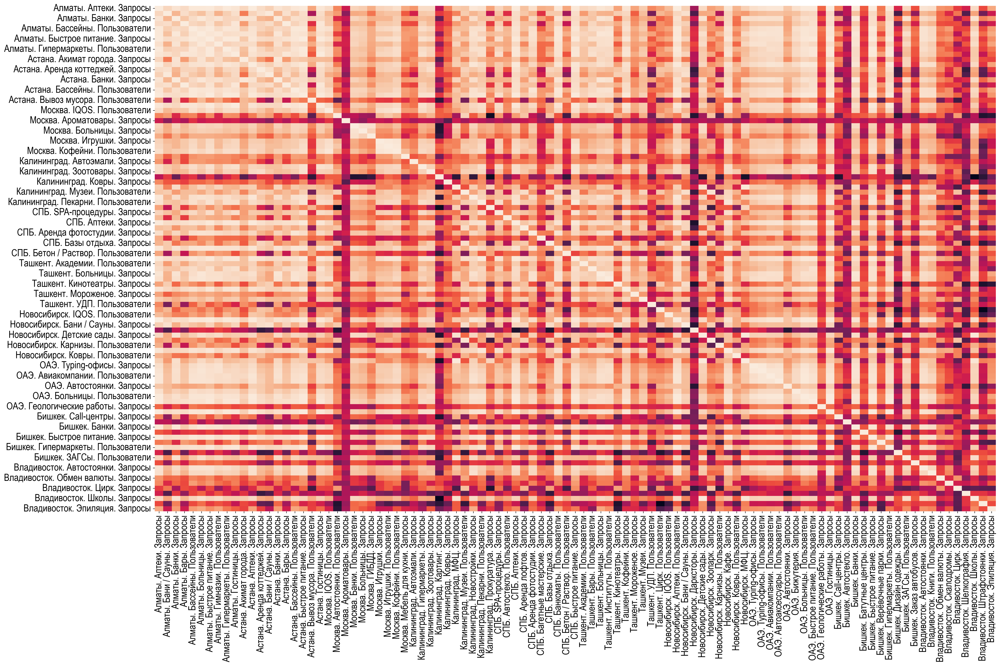

In [125]:
negative_corr = t1_100.sample(1000)
negative_corr_rubrics = pd.concat([negative_corr.r1, negative_corr.r2]).drop_duplicates().values
#negative_corr_rubrics = [i.replace('Москва. ', '') for i in negative_corr_rubrics]
negative_corr_rubrics = sorted(negative_corr_rubrics, key = lambda x: '0' if x.split('. ')[1].lower().strip() in bank_list_lower else str(random.randint(1, 100)))

df_dates_negative = df_dates_users[df_dates_users['city_rubric_param'].apply(lambda x: ((x in negative_corr_rubrics) and (len(x) < 35)))]
df_dates_negative['city_rubric_param'] = df_dates_negative['city_rubric_param']
dfx_pred = pd.pivot_table(df_dates_negative, values='cnt', aggfunc='sum', index=['date_r'], columns=['city_rubric_param'])
dfx_1 = dfx_pred[[ i for i in dfx_pred.columns if  'Алматы' in i]].iloc[:,:10]
dfx_2 = dfx_pred[[ i for i in dfx_pred.columns if  'Астана' in i]].iloc[:,:10]
dfx_3 = dfx_pred[[ i for i in dfx_pred.columns if  'Москва' in i]].iloc[:,:10]
dfx_4 = dfx_pred[[ i for i in dfx_pred.columns if  'Калининград' in i]].iloc[:,:10]
dfx_5 = dfx_pred[[ i for i in dfx_pred.columns if  'СПБ' in i]].iloc[:,:10]
dfx_6 = dfx_pred[[ i for i in dfx_pred.columns if  'Ташкент' in i]].iloc[:,:10]
dfx_7 = dfx_pred[[ i for i in dfx_pred.columns if  'Новосибирск' in i]].iloc[:,:10]
dfx_8 = dfx_pred[[ i for i in dfx_pred.columns if  'ОАЭ' in i]].iloc[:,:10]
dfx_9 = dfx_pred[[ i for i in dfx_pred.columns if  'Бишкек' in i]].iloc[:,:10]
dfx_10 = dfx_pred[[i for i in dfx_pred.columns if  'Владивосток' in i]].iloc[:,:10]
dfx = (dfx_1
.merge(dfx_2, left_index=True, right_index=True)
.merge(dfx_3, left_index=True, right_index=True)
.merge(dfx_4, left_index=True, right_index=True)
.merge(dfx_5, left_index=True, right_index=True)
.merge(dfx_6, left_index=True, right_index=True)
.merge(dfx_7, left_index=True, right_index=True)
.merge(dfx_8, left_index=True, right_index=True)
.merge(dfx_9, left_index=True, right_index=True)
.merge(dfx_10, left_index=True, right_index=True)
)

t_h = dfx.corr().fillna(0)

fig, ax = plt.subplots()
ax = sns.heatmap(t_h, annot=False, cbar=False)
plt.xticks(font=fpath, fontsize=18)
plt.yticks(font=fpath, fontsize=18)
plt.rcParams['figure.dpi'] = 2**8
plt.rcParams['figure.figsize']=size_x,size_y
ax.set_xlabel('')
ax.set_ylabel('')
#im = plt.imread(r"C:\Users\Mamed\YandexDisk\_Documents\Проекты\2ГИС 2023\Лого\Лого_2ГИС_230401_1600.png")
#ax.figure.figimage(im, 658, 44, zorder=1, alpha=0.5)

#im = plt.imread(r"C:\Users\Mamed\YandexDisk\_Documents\Проекты\2ГИС 2023\Лого\Лого_аватар_бел_180401_1930.jpg") 
#ax.figure.figimage(im, 358, 358, zorder=1, alpha=0.7)

fig.savefig(f'corr_matrix_other2.png', bbox_inches='tight', transparent=False, facecolor='white')
plt.show()

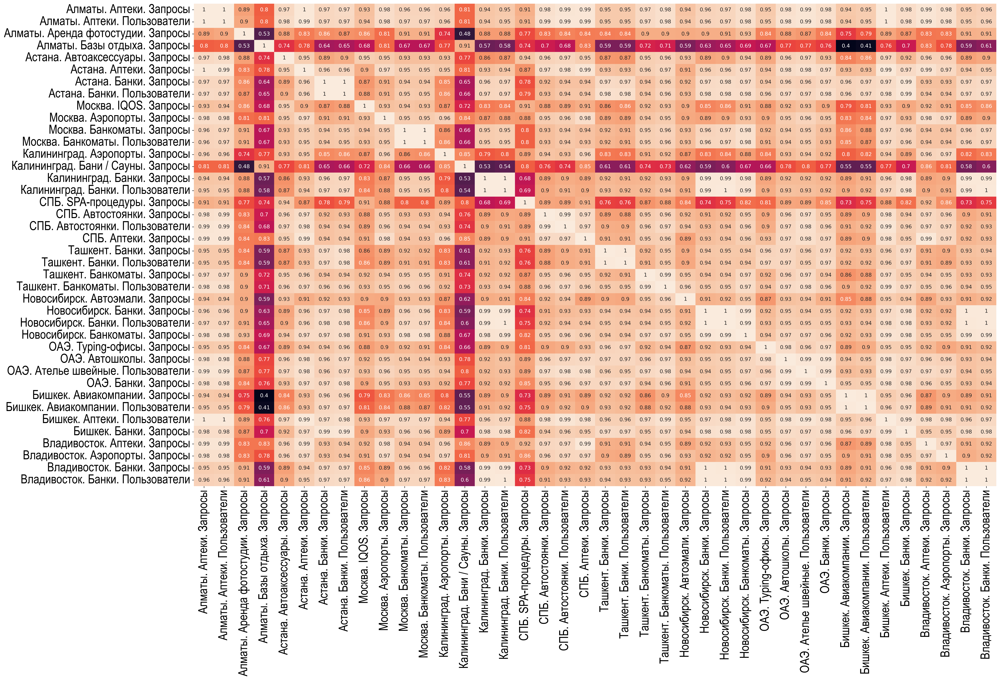

In [126]:
df_dates_all = df_dates_users
df_dates_all['city_rubric'] = df_dates_all['city_rubric_param']

positive_corr = t2[t2['corr'] >= 0.95]
positive_corr_rubrics = pd.concat([positive_corr.r1, positive_corr.r2]).drop_duplicates().values
#positive_corr_rubrics = [i.split('_')[1] for i in positive_corr_rubrics]
positive_corr_rubrics = sorted(positive_corr_rubrics, key = lambda x: '0' if x.split('. ')[1].lower().strip() in bank_list_lower else str(random.randint(1, 100)))


df_dates_positive = df_dates_all[df_dates_all['city_rubric'].apply(lambda x: ((x in positive_corr_rubrics[:500]) and (len(x) < 35)))]

dfx_pred = pd.pivot_table(df_dates_positive, values='cnt', aggfunc='sum', index=['date_r'], columns=['city_rubric'])
dfx_1 = dfx_pred[[ i for i in dfx_pred.columns if  'Алматы' in i]].iloc[:,:4]
dfx_2 = dfx_pred[[ i for i in dfx_pred.columns if  'Астана' in i]].iloc[:,:4]
dfx_3 = dfx_pred[[ i for i in dfx_pred.columns if  'Москва' in i]].iloc[:,:4]
dfx_4 = dfx_pred[[ i for i in dfx_pred.columns if  'Калининград' in i]].iloc[:,:4]
dfx_5 = dfx_pred[[ i for i in dfx_pred.columns if  'СПБ' in i]].iloc[:,:4]
dfx_6 = dfx_pred[[ i for i in dfx_pred.columns if  'Ташкент' in i]].iloc[:,:4]
dfx_7 = dfx_pred[[ i for i in dfx_pred.columns if  'Новосибирск' in i]].iloc[:,:4]
dfx_8 = dfx_pred[[ i for i in dfx_pred.columns if  'ОАЭ' in i]].iloc[:,:4]
dfx_9 = dfx_pred[[ i for i in dfx_pred.columns if  'Бишкек' in i]].iloc[:,:4]
dfx_10 = dfx_pred[[i for i in dfx_pred.columns if  'Владивосток' in i]].iloc[:,:4]
dfx = (dfx_1
.merge(dfx_2, left_index=True, right_index=True)
.merge(dfx_3, left_index=True, right_index=True)
.merge(dfx_4, left_index=True, right_index=True)
.merge(dfx_5, left_index=True, right_index=True)
.merge(dfx_6, left_index=True, right_index=True)
.merge(dfx_7, left_index=True, right_index=True)
.merge(dfx_8, left_index=True, right_index=True)
.merge(dfx_9, left_index=True, right_index=True)
.merge(dfx_10, left_index=True, right_index=True)
)

t_h = dfx.corr().fillna(0)

fig, ax = plt.subplots()
ax = sns.heatmap(t_h, annot=True, cbar=False)
plt.xticks(font=fpath, fontsize=24)
plt.yticks(font=fpath, fontsize=24)
plt.rcParams['figure.dpi'] = 2**8
plt.rcParams['figure.figsize']=size_x,size_y
ax.set_xlabel('')
ax.set_ylabel('')

fig.savefig(f'corr_matrix_1_other2.png', bbox_inches='tight', transparent=False, facecolor='white')
plt.show()

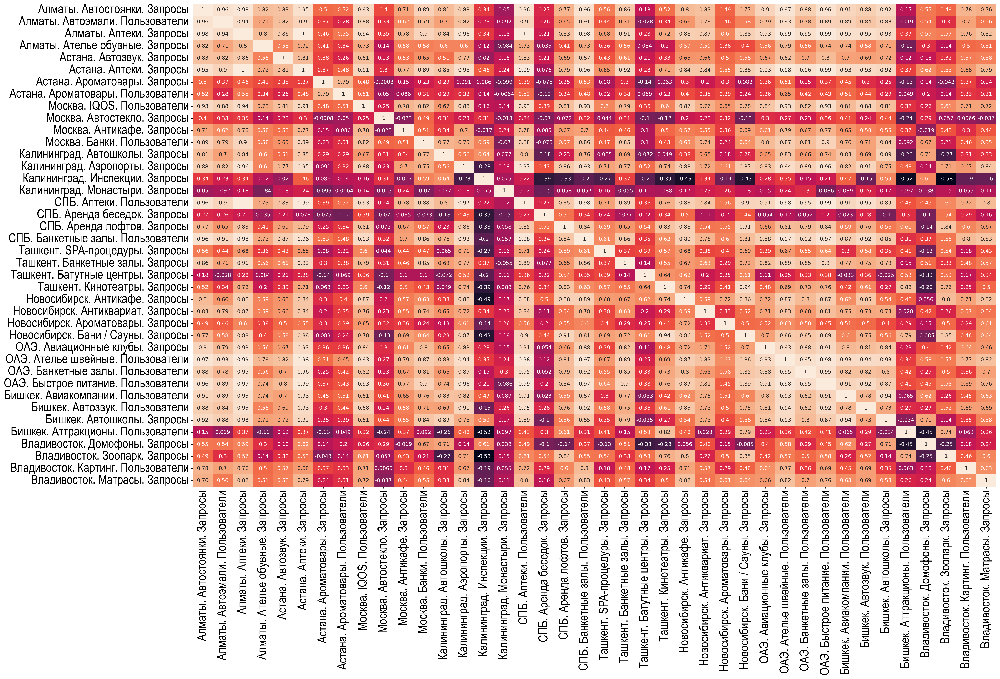

In [127]:
negative_corr = t1_100.sample(1000)
negative_corr_rubrics = pd.concat([negative_corr.r1, negative_corr.r2]).drop_duplicates().values
#negative_corr_rubrics = [i.replace('Москва. ', '') for i in negative_corr_rubrics]
negative_corr_rubrics = sorted(negative_corr_rubrics, key = lambda x: '0' if x.split('. ')[1].lower().strip() in bank_list_lower else str(random.randint(1, 100)))

df_dates_negative = df_dates_users[df_dates_users['city_rubric_param'].apply(lambda x: ((x in negative_corr_rubrics) and (len(x) < 35)))]
df_dates_negative['city_rubric_param'] = df_dates_negative['city_rubric_param']
dfx_pred = pd.pivot_table(df_dates_negative, values='cnt', aggfunc='sum', index=['date_r'], columns=['city_rubric_param'])
dfx_1 = dfx_pred[[ i for i in dfx_pred.columns if  'Алматы' in i]].iloc[:,:4]
dfx_2 = dfx_pred[[ i for i in dfx_pred.columns if  'Астана' in i]].iloc[:,:4]
dfx_3 = dfx_pred[[ i for i in dfx_pred.columns if  'Москва' in i]].iloc[:,:4]
dfx_4 = dfx_pred[[ i for i in dfx_pred.columns if  'Калининград' in i]].iloc[:,:4]
dfx_5 = dfx_pred[[ i for i in dfx_pred.columns if  'СПБ' in i]].iloc[:,:4]
dfx_6 = dfx_pred[[ i for i in dfx_pred.columns if  'Ташкент' in i]].iloc[:,:4]
dfx_7 = dfx_pred[[ i for i in dfx_pred.columns if  'Новосибирск' in i]].iloc[:,:4]
dfx_8 = dfx_pred[[ i for i in dfx_pred.columns if  'ОАЭ' in i]].iloc[:,:4]
dfx_9 = dfx_pred[[ i for i in dfx_pred.columns if  'Бишкек' in i]].iloc[:,:4]
dfx_10 = dfx_pred[[i for i in dfx_pred.columns if  'Владивосток' in i]].iloc[:,:4]
dfx = (dfx_1
.merge(dfx_2, left_index=True, right_index=True)
.merge(dfx_3, left_index=True, right_index=True)
.merge(dfx_4, left_index=True, right_index=True)
.merge(dfx_5, left_index=True, right_index=True)
.merge(dfx_6, left_index=True, right_index=True)
.merge(dfx_7, left_index=True, right_index=True)
.merge(dfx_8, left_index=True, right_index=True)
.merge(dfx_9, left_index=True, right_index=True)
.merge(dfx_10, left_index=True, right_index=True)
)

t_h = dfx.corr().fillna(0)

fig, ax = plt.subplots()
ax = sns.heatmap(t_h, annot=True, cbar=False)
plt.xticks(font=fpath, fontsize=24)
plt.yticks(font=fpath, fontsize=24)
plt.rcParams['figure.dpi'] = 2**8
plt.rcParams['figure.figsize']=size_x,size_y
ax.set_xlabel('')
ax.set_ylabel('')

fig.savefig(f'corr_matrix_2_other2.png', bbox_inches='tight', transparent=False, facecolor='white')
plt.show()

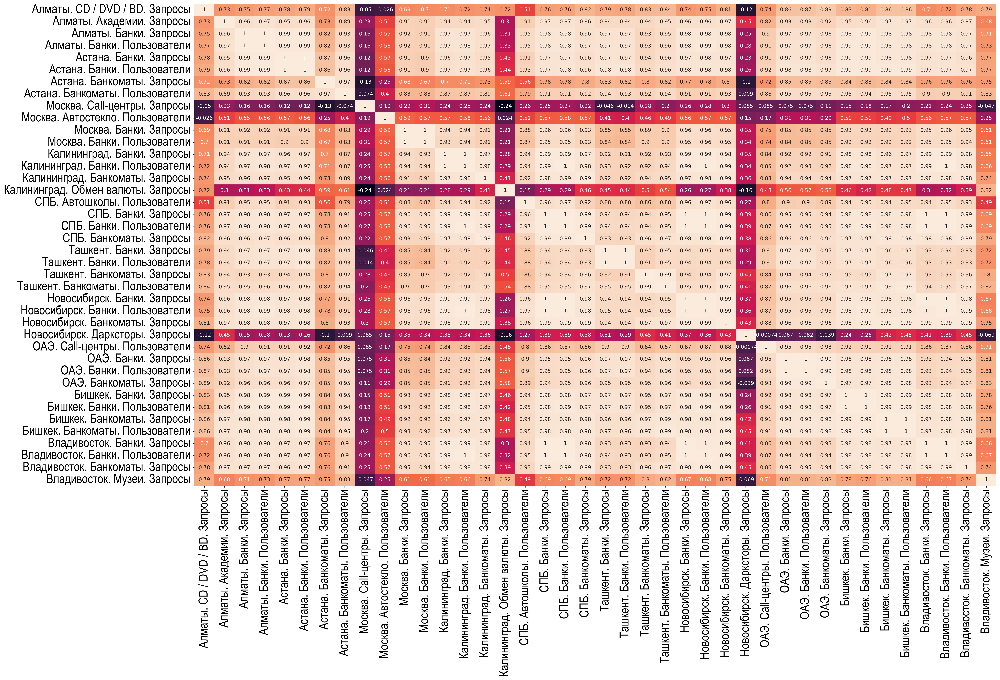

In [128]:
zero_corr = t1[t1['corr'] < abs(0.41)]
zero_corr_rubrics = pd.concat([zero_corr.r1, zero_corr.r2]).drop_duplicates().values
zero_corr_rubrics = [i.split('_')[1] for i in zero_corr_rubrics]
zero_corr_rubrics = sorted(zero_corr_rubrics, key = lambda x: '0' if x.split('. ')[1].lower().strip() in bank_list_lower else str(random.randint(1, 100)))

df_dates_zero = df_dates_all[df_dates_all['city_rubric'].apply(lambda x: (x in zero_corr_rubrics[:500]) and (len(x) < 35) )]

dfx_pred = pd.pivot_table(df_dates_zero, values='cnt', aggfunc='sum', index=['date_r'], columns=['city_rubric'])
dfx_1 = dfx_pred[[ i for i in dfx_pred.columns if  'Алматы' in i]].iloc[:,:4]
dfx_2 = dfx_pred[[ i for i in dfx_pred.columns if  'Астана' in i]].iloc[:,:4]
dfx_3 = dfx_pred[[ i for i in dfx_pred.columns if  'Москва' in i]].iloc[:,:4]
dfx_4 = dfx_pred[[ i for i in dfx_pred.columns if  'Калининград' in i]].iloc[:,:4]
dfx_5 = dfx_pred[[ i for i in dfx_pred.columns if  'СПБ' in i]].iloc[:,:4]
dfx_6 = dfx_pred[[ i for i in dfx_pred.columns if  'Ташкент' in i]].iloc[:,:4]
dfx_7 = dfx_pred[[ i for i in dfx_pred.columns if  'Новосибирск' in i]].iloc[:,:4]
dfx_8 = dfx_pred[[ i for i in dfx_pred.columns if  'ОАЭ' in i]].iloc[:,:4]
dfx_9 = dfx_pred[[ i for i in dfx_pred.columns if  'Бишкек' in i]].iloc[:,:4]
dfx_10 = dfx_pred[[i for i in dfx_pred.columns if  'Владивосток' in i]].iloc[:,:4]
dfx = (dfx_1
.merge(dfx_2, left_index=True, right_index=True)
.merge(dfx_3, left_index=True, right_index=True)
.merge(dfx_4, left_index=True, right_index=True)
.merge(dfx_5, left_index=True, right_index=True)
.merge(dfx_6, left_index=True, right_index=True)
.merge(dfx_7, left_index=True, right_index=True)
.merge(dfx_8, left_index=True, right_index=True)
.merge(dfx_9, left_index=True, right_index=True)
.merge(dfx_10, left_index=True, right_index=True)
)

t_h = dfx.corr().fillna(0)

fig, ax = plt.subplots()
ax = sns.heatmap(t_h, annot=True, cbar=False)
plt.xticks(font=fpath, fontsize=24)
plt.yticks(font=fpath, fontsize=24)
plt.rcParams['figure.dpi'] = 2**8
plt.rcParams['figure.figsize']=size_x,size_y
ax.set_xlabel('')
ax.set_ylabel('')

fig.savefig(f'corr_matrix_3_other2.png', bbox_inches='tight', transparent=False, facecolor='white')
plt.show()

In [129]:
doc_file = 'corr_matrix_new.docx'

In [130]:
def add_text(text, doc_file=doc_file):
    doc = docx.Document(doc_file)
    doc.add_paragraph(text)
    doc.save(doc_file)

In [133]:
add_text('Бизнес. Общая\n')
add_image_request(doc_file, 'corr_matrix.png')
add_text('Бизнес. Позитивная\n')
add_image_request(doc_file, 'corr_matrix_1.png')
add_text('Бизнес. Негативная\n')
add_image_request(doc_file, 'corr_matrix_2.png')
add_text('Бизнес. Нейтральная\n')
add_image_request(doc_file, 'corr_matrix_3.png')

In [134]:
add_text('Бизнес. Город. Общая\n')
add_image_request(doc_file, 'corr_matrix_other.png')
add_text('Бизнес. Город. Позитивная\n')
add_image_request(doc_file, 'corr_matrix_1_other.png')
add_text('Бизнес. Город. Негативная\n')
add_image_request(doc_file, 'corr_matrix_2_other.png')
add_text('Бизнес. Город. Нейтральная\n')
add_image_request(doc_file, 'corr_matrix_3_other.png')

In [135]:
add_text('Бизнес. Город. Показатель. Общая\n')
add_image_request(doc_file, 'corr_matrix_other2.png')
add_text('Бизнес. Город. Показатель. Позитивная\n')
add_image_request(doc_file, 'corr_matrix_1_other2.png')
add_text('Бизнес. Город. Показатель. Негативная\n')
add_image_request(doc_file, 'corr_matrix_2_other2.png')
add_text('Бизнес. Город. Показатель. Нейтральная\n')
add_image_request(doc_file, 'corr_matrix_3_other2.png')

In [109]:
add_text('Бизнес. Общая\n')
add_image_request(doc_file, 'corr_matrix.png')
add_text('Бизнес. Позитивная\n')
add_image_request(doc_file, 'corr_matrix_1.png')
add_text('Бизнес. Негативная\n')
add_image_request(doc_file, 'corr_matrix_2.png')
add_text('Бизнес. Нейтральная\n')
add_image_request(doc_file, 'corr_matrix_3.png')

# 10 городов формулы

In [1]:
%run functions.ipynb
#spark = get_spark()

Ready: 2023-07-29 23:01:57


In [2]:
bank_list = ['Банки',
'Банкоматы',
'Бюро кредитных историй',
'Инвестиционные компании',
'Ипотечное / жилищное кредитование',
'Кредитные потребительские кооперативы',
'Лизинговые услуги',
'Ломбарды',
'Микрофинансирование',
'Обмен валюты',
'Операции на фондовом рынке',
'Паевые инвестиционные фонды (ПИФы)',
'Продажа инвестиционных драгоценных металлов / бриллиантов',
'Системы денежных переводов',
'Услуги факторинга',
'Негосударственные пенсионные фонды',
'Сельскохозяйственные кредитные потребительские кооперативы',
'Банковское оборудование',
'Ремонт банковского оборудования',
]

In [3]:
bank_list_lower = [i.lower() for i in bank_list]

In [9]:
%%time
exclude_rubrics = ['Общая рубрика ЗМК','Заказ такси','Спектакли','Детские дома и Приюты','Кладбища','Крематории','Памятники / Ритуальные принадлежности','Помощь в организации похорон','Прощальные залы','Воскресные школы','Дацаны','Духовные учебные заведения','Иконописные мастерские','Медресе','Мечети','Молитвенные комнаты','Монастыри','Паломнические поездки','Приходы','Религиозные организации','Религиозные товары','Синагога','Храмы / Соборы / Церкви','Часовни','Радиостанции','Телеканалы','Телекомпании / Радиокомпании','Герои с нашего двора','Отлов бездомных животных','Приюты для животных','Ритуальные услуги для животных','Выгодные покупки с 2ГИС','Ликвидация нефтеразливов / газонефтеводопроявлений','Библиотеки','Библиотечные коллекторы','Городские оркестры','Кинопрокатные компании','Киностудии','Мавзолей','Музеи','Планетарий','Реставрация памятников истории и культуры','Театры','Филармония','Хоровые капеллы','Художественные выставки / Галереи','Аварийные службы','Пожарная охрана','Скорая медицинская помощь','Службы аварийных комиссаров','Службы спасения / экстренного вызова','Справочно-информационные услуги','Телефоны доверия','Управление ГО и ЧС','Штрафстоянки','Эвакуация автомобилей','Администрации поселений','Администрации районов / округов городской власти','Администрации районов / округов региональной власти','Администрация города / городского округа','Администрация области / края','Правительство','Пенсионные фонды','Фонд обязательного медицинского страхования','Фонды социального страхования','Законодательная власть','Представительная власть','Военная комендатура','Военные комиссариаты','Благотворительные фонды','Венчурные фонды','Гарантийные фонды','ГОРПО / РАЙПО','Гранты','Залоговые фонды','Избирательные комиссии','Избирательные участки','Нотариальные палаты','Общественные группы','Общественные организации','Политические партии','Приёмные депутатов','Приёмные Президента','Приёмные Уполномоченных по правам человека','Территориальные общественные самоуправления','Гидрометеослужба','Организации природоохраны','Инспекции','Налоговые инспекции','Оператор системы взимания платы','Органы государственного надзора','Отделы ветеринарно-санитарного контроля','Службы мелиорации земель','Федеральные казначейства','Федеральные службы','Посольства / Консульства','Представительства субъектов РФ','ГИБДД','Главное управление по вопросам миграции МВД РФ','Изоляторы временного содержания / Спецприёмники','Исправительные учреждения','Медвытрезвители','Народные дружины','Общественные пункты охраны порядка','ОМВД / УМВД / ГУМВД / МВД','Отделения полиции','Прокуратура','Следственный комитет','Службы судебных приставов','Судебная / внесудебная экспертиза','Суды','Таможня','Участковые пункты полиции','Государственные архивы','ЗАГСы','Бэби-боксы','Детские дома / Приюты','Дома престарелых','Дома ребёнка','Молочные кухни','МФЦ','Ночлежные дома','Отделы доставки пенсий и пособий','Службы занятости населения','Социальные службы','Центры квотирования рабочих мест','Антиквариат','Багетные мастерские','Подвеска / Подсветка для картин','Филателия / Нумизматика','Художественные мастерские','Художественные товары','Общая рубрика ЗМК','Заказ такси','Спектакли','Детские дома и Приюты','Автовокзалы и Автостанции','Аэропорты','Контрольные браслеты','Онлайн-заправки 2ГИС','Спички','Лицеи-интернаты','Экспертиза авиационных происшествий','Саморегулируемые организации (СРО)','Аренда жид тупика','Ритуальные принадлежности','Железнодорожные вокзалы','Ликвидация нефтеразливов и газонефтеводопроявлений','Больницы','Дома и дворцы культуры','Санатории и Профилактории','Телекомпании и Радиокомпании','Организация театральных и концертных мероприятий','Акиматы районов города','Управление ГО и ЧС', 'ЦОН','ОМВД / УМВД / ГУМВД и МВД ','CD / DVD и BD','Лучшие достопримечательности города','Изоляторы временного содержания и Спецприёмники','Администрации районов и округов городской власти','Администрация города и городского округа','Полицейские академии','Акимат города','Почтовые отделения', 'Взрослые поликлиники', 'Кладбища','Крематории','Памятники / Ритуальные принадлежности','Помощь в организации похорон','Прощальные залы','Воскресные школы','Дацаны','Духовные учебные заведения','Иконописные мастерские','Медресе','Мечети','Молитвенные комнаты','Монастыри','Паломнические поездки','Приходы','Религиозные организации','Религиозные товары','Синагога','Храмы / Соборы / Церкви','Часовни','Радиостанции','Телеканалы','Телекомпании / Радиокомпании','Герои с нашего двора','Отлов бездомных животных','Приюты для животных','Ритуальные услуги для животных','Выгодные покупки с 2ГИС','Ликвидация нефтеразливов / газонефтеводопроявлений','Библиотеки','Библиотечные коллекторы','Городские оркестры','Кинопрокатные компании','Киностудии','Мавзолей','Музеи','Планетарий','Реставрация памятников истории и культуры','Театры','Филармония','Хоровые капеллы','Художественные выставки / Галереи','Аварийные службы','Пожарная охрана','Скорая медицинская помощь','Службы аварийных комиссаров','Службы спасения / экстренного вызова','Справочно-информационные услуги','Телефоны доверия','Управление ГО и ЧС','Штрафстоянки','Эвакуация автомобилей','Администрации поселений','Администрации районов / округов городской власти','Администрации районов / округов региональной власти','Администрация города / городского округа','Администрация области / края','Правительство','Пенсионные фонды','Фонд обязательного медицинского страхования','Фонды социального страхования','Законодательная власть','Представительная власть','Военная комендатура','Военные комиссариаты','Благотворительные фонды','Венчурные фонды','Гарантийные фонды','ГОРПО / РАЙПО','Гранты','Залоговые фонды','Избирательные комиссии','Избирательные участки','Нотариальные палаты','Общественные группы','Общественные организации','Политические партии','Приёмные депутатов','Приёмные Президента','Приёмные Уполномоченных по правам человека','Территориальные общественные самоуправления','Гидрометеослужба','Организации природоохраны','Инспекции','Налоговые инспекции','Оператор системы взимания платы','Органы государственного надзора','Отделы ветеринарно-санитарного контроля','Службы мелиорации земель','Федеральные казначейства','Федеральные службы','Посольства / Консульства','Представительства субъектов РФ','ГИБДД','Главное управление по вопросам миграции МВД РФ','Изоляторы временного содержания / Спецприёмники','Исправительные учреждения','Медвытрезвители','Народные дружины','Общественные пункты охраны порядка','ОМВД / УМВД / ГУМВД / МВД','Отделения полиции','Прокуратура','Следственный комитет','Службы судебных приставов','Судебная / внесудебная экспертиза','Суды','Таможня','Участковые пункты полиции','Государственные архивы','ЗАГСы','Бэби-боксы','Детские дома / Приюты','Дома престарелых','Дома ребёнка','Молочные кухни','МФЦ','Ночлежные дома','Отделы доставки пенсий и пособий','Службы занятости населения','Социальные службы','Центры квотирования рабочих мест','Воскресные школы','Дацаны','Духовные учебные заведения','Иконописные мастерские','Медресе','Мечети','Молитвенные комнаты','Монастыри','Паломнические поездки','Приходы','Религиозные организации','Религиозные товары','Синагога','Храмы / Соборы / Церкви','Часовни','Антиквариат','Багетные мастерские','Подвеска / Подсветка для картин','Филателия / Нумизматика','Художественные мастерские','Художественные товары' 'Железнодорожные вокзалы', 'Музеи','Центры паровых коктейлей', 'Школы', 'Университеты', 'Больницы','Табачные изделия / Товары для курения','Художественные выставки / Галереи','Научно-исследовательские институты', 'Храмы / Соборы / Церкви', 'Студенческие общежития'
]

city = 'Москва'
df_all = pd.read_parquet(f'files/ten_city/df_dates_users_city_agg2')
#df_all = df_all[df_all['city'] == city]
df_all['city_rubric'] = df_all['city'] + '. ' + df_all['rubric']
df_all = df_all[~df_all.rubric.apply(lambda x: (x is None or x.isnumeric()))]
df_all['cnt_all'] = df_all.groupby('city_rubric')['cnt_requests'].transform(np.sum)
df_all = df_all.drop(['date_r', 'cnt_requests', 'cnt_users'], axis=1).drop_duplicates()
df_all = df_all.sort_values(['cnt_all'], ascending=False).reset_index().reset_index().set_index('level_0').drop('index', axis=1)
df_all['cnt_city_rubric'] = df_all['cnt_all'].astype(str) + '_' + df_all['city_rubric'] + '. ' + 'Запросы'
df_requests = df_all.copy()

df_all = pd.read_parquet(f'files/ten_city/df_dates_users_city_agg2')
#df_all = df_all[df_all['city'] == city]
df_all['city_rubric'] = df_all['city'] + '. ' + df_all['rubric']
df_all = df_all[~df_all.rubric.apply(lambda x: (x is None or x.isnumeric()))]
df_all['cnt_all'] = df_all.groupby('city_rubric')['cnt_users'].transform(np.sum)
df_all = df_all.drop(['date_r', 'cnt_requests', 'cnt_users'], axis=1).drop_duplicates()
df_all = df_all.sort_values(['cnt_all'], ascending=False).reset_index().reset_index().set_index('level_0').drop('index', axis=1)
df_all['cnt_city_rubric'] = df_all['cnt_all'].astype(str) + '_' + df_all['city_rubric'] + '. ' + 'Пользователи'
df_users = df_all.copy()

df_1000 = pd.concat([df_requests, df_users])
df_1000 = df_1000[df_1000.rubric.apply(lambda x: x not in exclude_rubrics)]
df_1000['param'] = df_1000.cnt_city_rubric.apply(lambda x: x.split('. ')[2])

df_1000['r_cnt'] = df_1000.groupby('rubric')['cnt_all'].transform(np.sum)
df_1000_1 = df_1000.sort_values(['r_cnt', 'city'], ascending=[False, True]).rename({'cnt_city_rubric':'cnt_city_rubric_param'}, axis=1)
df_1000_1['city_rubric_param'] = df_1000_1['city_rubric'] + '. ' + df_1000_1['param']

rubrics = [*df_1000_1.rubric.drop_duplicates().values]
cities = [*df_1000_1.city.unique()] * 139
params = [*df_1000_1.param.values]

#iter_set = list(zip(rubrics, cities, params))
#iter_df = pd.DataFrame(iter_set, columns=['rubric', 'city', 'param'])
#iter_df['city_rubric_param'] = iter_df['city'] + '. ' + iter_df['rubric'] + '. ' + iter_df['param']
#iter_df = df_1000_1[['city_rubric_param', 'cnt_city_rubric_param']].merge(iter_df, left_on='city_rubric_param', right_on='city_rubric_param')

iter_set = list(zip(bank_list*20, cities, params))
iter_df = pd.DataFrame(iter_set, columns=['rubric', 'city', 'param'])
iter_df['city_rubric_param'] = iter_df['city'] + '. ' + iter_df['rubric'] + '. ' + iter_df['param']
iter_df = df_1000_1[['city_rubric_param', 'cnt_city_rubric_param']].merge(iter_df, left_on='city_rubric_param', right_on='city_rubric_param')

iter_set2 = list(itertools.product(set(bank_list), set(cities), set(params)))
iter_df2 = pd.DataFrame(iter_set2, columns=['rubric', 'city', 'param'])
iter_df2['city_rubric_param'] = iter_df2['city'] + '. ' + iter_df2['rubric'] + '. ' + iter_df2['param']
iter_df2 = df_1000_1[['city_rubric_param', 'cnt_city_rubric_param']].merge(iter_df2, left_on='city_rubric_param', right_on='city_rubric_param')

## Переменные формулы
df1 = pd.read_parquet(f'files/ten_city/df_dates_users_city_agg2')
#df1 = df1[df1['city'] == city]
df1['city_rubric_param'] = df1['city'] + '. ' + df1['rubric'] + '. ' + 'Пользователи'
df1 = df1[['date_r', 'cnt_users', 'city_rubric_param']].rename({'cnt_users':'cnt'}, axis=1)

df2 = pd.read_parquet(f'files/ten_city/df_dates_users_city_agg2')
#df2 = df2[df2['city'] == city]
df2['city_rubric_param'] = df2['city'] + '. ' + df2['rubric'] + '. ' + 'Запросы'
df2 = df2[['date_r', 'cnt_requests', 'city_rubric_param']].rename({'cnt_requests':'cnt'}, axis=1)
df_dates_users = pd.concat([df1, df2])
df_dates_users['cnt_all'] = df_dates_users.groupby('city_rubric_param')['cnt'].transform(np.sum)
df_dates_users['city_rubric_param_cnt'] = df_dates_users['cnt_all'].astype(str) + '_' + df_dates_users['city_rubric_param']

dfx = pd.pivot_table(df_dates_users, values='cnt', aggfunc='sum', index=['date_r'], columns=['city_rubric_param_cnt'])

CPU times: total: 4.73 s
Wall time: 7.29 s


In [10]:
dfx = dfx.loc[:,list(iter_df.cnt_city_rubric_param) + list(iter_df2.cnt_city_rubric_param)]
t = dfx.corr().fillna(0).astype(np.float16)

t = t.rename_axis([None]).rename_axis([None], axis=1)
t1 = t.stack()
t1 = t1.reset_index()
t1.columns = ['r1', 'r2', 'corr']
t1 = t1[t1.r1 != t1.r2]

In [11]:
t1_100 = t1.drop_duplicates() #df_100.merge(t1, left_on='cnt_city_rubric', right_on='r1')

t1_100['r1_cnt'] = t1_100.r1.apply(lambda x: x.split('_')[0])
t1_100['r2_cnt'] = t1_100.r2.apply(lambda x: x.split('_')[0])

t1_100.r1 = t1_100.r1.apply(lambda x: x.split('_')[1])
t1_100.r2 = t1_100.r2.apply(lambda x: x.split('_')[1])
t1_100['r1_city'] = t1_100.r1.apply(lambda x: x.split('. ')[0])
t1_100['r2_city'] = t1_100.r2.apply(lambda x: x.split('. ')[0])
t1_100['r1_rubric'] = t1_100.r1.apply(lambda x: x.split('. ')[1])
t1_100['r2_rubric'] = t1_100.r2.apply(lambda x: x.split('. ')[1])
t1_100['r1_param'] = t1_100.r1.apply(lambda x: x.split('. ')[2])
t1_100['r2_param'] = t1_100.r2.apply(lambda x: x.split('. ')[2])

t1_100.r1_cnt = t1_100.r1_cnt.astype(int)
t1_100.r2_cnt = t1_100.r2_cnt.astype(int)

#t1_100 = t1_100[t1_100.r2_cnt > 1000]

t1_100 = t1_100[['r1_city', 'r1_rubric', 'r1_param', 'r2_city', 'r2_rubric', 'r2_param', 'corr', 'r1_cnt', 'r2_cnt']]

In [122]:
iter_set = list(zip(iter_df3.rubric, iter_df3.city, iter_df3.param))


In [138]:
x = iter_set.pop(0)

In [139]:
x

('Микрофинансирование', 'СПБ', 'Запросы')

In [157]:
iter_set.pop(0)

('Услуги факторинга', 'Владивосток', 'Пользователи')

In [158]:
iter_set = list(zip(iter_df3.rubric, iter_df3.city, iter_df3.param))


In [155]:
for rubric  in (iter_set.pop(0)):
    print(rubric, city, param)

Системы денежных переводов Ташкент Пользователи
Бишкек Ташкент Пользователи
Запросы Ташкент Пользователи


In [161]:
iter_set[0]

IndexError: list index out of range

In [ ]:
iter_set = list(zip(iter_df3.rubric, iter_df3.city, iter_df3.param))

In [162]:
%%time
dfo = pd.read_excel(r"C:\Users\Mamed\Downloads\archive\Рубрикатор_230605_0030_отметки красным.xlsx")[['Отрасль', 'Рубрика']].dropna(subset='Отрасль')
t1_100_all = t1_100
t1_100_city = t1_100#[(t1_100.r1_city == result_city) & (t1_100.r2_city == variables_city) & (t1_100.r1_param == result_param) & (t1_100.r2_param == variables_param)]
r_list = [t1_100_all.r1_rubric.iloc[:0]]

iter_set_new = (list(zip(range(1000),bank_list*20, cities, params)))
iter_df3 = pd.DataFrame(iter_set_new, columns=['index','rubric', 'city', 'param'])
iter_df3['city_rubric_param'] = iter_df3['city'] + '. ' + iter_df3['rubric'] + '. ' + iter_df3['param']
iter_df3 = df_1000_1[['city_rubric_param', 'cnt_city_rubric_param']].merge(iter_df3, left_on='city_rubric_param', right_on='city_rubric_param')
iter_df3 = iter_df3.sort_values('index').set_index('index')

iter_set = list(zip(iter_df3.rubric, iter_df3.city, iter_df3.param))

### f13
df_list = []
for rubric, city, param in [iter_set[0]]:
    iter_set.pop(0)
    print(rubric, city)
    f1_i = t1_100_all[(t1_100_all.r1_city == city) & (t1_100_all.r1_rubric == rubric)]
    f1_i.sort_values(['corr', 'r2_cnt'], ascending=[False,False], inplace=True)
    f1_i = f1_i.merge(dfo, left_on='r1_rubric', right_on='Рубрика').drop('Рубрика',axis=1).rename({'Отрасль':'r1_otrasl'}, axis=1)
    f1_i = f1_i.merge(dfo, left_on='r2_rubric', right_on='Рубрика').drop('Рубрика',axis=1).rename({'Отрасль':'r2_otrasl'}, axis=1)
    f1_i = f1_i[f1_i['r1_otrasl'] == f1_i['r2_otrasl']]
    f1_i = f1_i[f1_i.r2_rubric.apply(lambda x: (not x.isdigit()) & (len(x) <= 50) & (x not in f1_i.r1_rubric.values))].drop_duplicates(subset='r2_rubric', keep="first")
    f1_i = f1_i.iloc[:20]
    f1_i['avg_corr'] = f1_i['corr'].mean()
    #r_list.append(f1_i.r1_rubric.drop_duplicates())
    #r_list.append(f1_i.r2_rubric.drop_duplicates())
    df_list.append(f1_i)
f13 = pd.concat(df_list)
f13['group'] = 'f13'


### f14
df_list = []
for rubric, city, param in [iter_set[0]]:
    iter_set.pop(0)
    print(rubric, city)
    f1_i = t1_100_all[(t1_100_all.r1_city == city) & (t1_100_all.r1_rubric == rubric)]
    f1_i.sort_values(['corr', 'r2_cnt'], ascending=[False,False], inplace=True)
    f1_i = f1_i.merge(dfo, left_on='r1_rubric', right_on='Рубрика').drop('Рубрика',axis=1).rename({'Отрасль':'r1_otrasl'}, axis=1)
    f1_i = f1_i.merge(dfo, left_on='r2_rubric', right_on='Рубрика').drop('Рубрика',axis=1).rename({'Отрасль':'r2_otrasl'}, axis=1)
    f1_i = f1_i[f1_i['r1_otrasl'] != f1_i['r2_otrasl']]
    f1_i = f1_i[f1_i.r2_rubric.apply(lambda x: (not x.isdigit()) & (len(x) <= 50) & (x not in f1_i.r1_rubric.values))].drop_duplicates(subset='r2_rubric', keep="first")
    f1_i = f1_i.iloc[:20]
    f1_i['avg_corr'] = f1_i['corr'].mean()
    r_list.append(f1_i.r1_rubric.drop_duplicates())
    r_list.append(f1_i.r2_rubric.drop_duplicates())
    df_list.append(f1_i)
f14 = pd.concat(df_list)
f14['group'] = 'f14'


### f15
df_list = []
for rubric, city, param in [iter_set[0]]:
    iter_set.pop(0)
    print(rubric, city)
    f1_i = t1_100_all[(t1_100_all.r1_city == city) & (t1_100_all.r1_rubric == rubric)]
    f1_i.sort_values(['corr', 'r2_cnt'], ascending=[False,False], inplace=True)
    f1_i = f1_i.merge(dfo, left_on='r1_rubric', right_on='Рубрика').drop('Рубрика',axis=1).rename({'Отрасль':'r1_otrasl'}, axis=1)
    f1_i = f1_i.merge(dfo, left_on='r2_rubric', right_on='Рубрика').drop('Рубрика',axis=1).rename({'Отрасль':'r2_otrasl'}, axis=1)
    f1_i = f1_i[f1_i.r2_rubric.apply(lambda x: (not x.isdigit()) & (len(x) <= 50) & (x not in f1_i.r1_rubric.values))].drop_duplicates(subset='r2_rubric', keep="first")
    f1_i_1 = f1_i[f1_i['r1_otrasl'] != f1_i['r2_otrasl']].iloc[:10]
    f1_i_2 = f1_i[f1_i['r1_otrasl'] == f1_i['r2_otrasl']].iloc[:10]
    f1_i = pd.concat([f1_i_1, f1_i_2])
    f1_i['avg_corr'] = f1_i['corr'].mean()
    r_list.append(f1_i.r1_rubric.drop_duplicates())
    r_list.append(f1_i.r2_rubric.drop_duplicates())
    df_list.append(f1_i)
f15 = pd.concat(df_list)
f15['group'] = 'f15'


### f1
df_list = []
for rubric, city, param in [iter_set[0]]:
    iter_set.pop(0)
    f1_i = t1_100_city[(t1_100_city.r1_city == city) & (t1_100_city.r1_rubric == rubric)].sort_values(['corr', 'r2_cnt'], ascending=[False,False])
    f1_i = f1_i[f1_i.r2_rubric.apply(lambda x: (not x.isdigit()) & (len(x) <= 50) & (x not in f1_i.r1_rubric.values))].drop_duplicates(subset='r2_rubric', keep="first")
    f1_i = f1_i.iloc[:20]
    f1_i['avg_corr'] = f1_i['corr'].mean()
    r_list.append(f1_i.r1_rubric.drop_duplicates())
    r_list.append(f1_i.r2_rubric.drop_duplicates())
    df_list.append(f1_i)
f1 = pd.concat(df_list)
f1['group'] = 'f1'

### f2
df_list = []
for rubric, city, param in [iter_set[0]]:
    iter_set.pop(0)
    f1_i = t1_100_city[(t1_100_city.r1_city == city) & (t1_100_city.r1_rubric == rubric)].sort_values(['corr', 'r2_cnt'], ascending=[True,False])
    f1_i = f1_i[f1_i.r2_rubric.apply(lambda x: (not x.isdigit()) & (len(x) <= 50) & (x not in f1_i.r1_rubric.values))].drop_duplicates(subset='r2_rubric', keep="first")
    f1_i = f1_i.iloc[:20]
    f1_i['avg_corr'] = f1_i['corr'].mean()
    r_list.append(f1_i.r1_rubric.drop_duplicates())
    r_list.append(f1_i.r2_rubric.drop_duplicates())
    df_list.append(f1_i)
f2 = pd.concat(df_list)
f2['group'] = 'f2'

### f3
df_list = []
for rubric, city, param in [iter_set[0]]:
    iter_set.pop(0)
    t1_c1 = t1_100_city[(t1_100_city.r1_city == city) & (t1_100_city.r1_rubric == rubric)]
    t1_c1['corr_abs'] = t1_c1['corr'].abs()
    t1_c1.sort_values(['corr_abs', 'r2_cnt'], ascending=[False,False], inplace=True)
    f1_i = t1_c1.iloc[:]
    f1_i = f1_i[f1_i.r2_rubric.apply(lambda x: (not x.isdigit()) & (len(x) <= 50) & (x not in f1_i.r1_rubric.values))].drop_duplicates(subset='r2_rubric', keep="first")
    f1_i = f1_i.iloc[:20].drop('corr_abs', axis=1)
    f1_i['avg_corr'] = f1_i['corr'].mean()
    r_list.append(f1_i.r1_rubric.drop_duplicates())
    r_list.append(f1_i.r2_rubric.drop_duplicates())
    df_list.append(f1_i)
f3 = pd.concat(df_list)
f3['group'] = 'f3'

### f4
#### органическая – для построения тренда используются смысловые ряды переменных: запросы базируются на запросах, пользователи на пользователях, динамика на динамике, схожесть на схожести
df_list = []
for rubric, city, param in [iter_set[0]]:
    iter_set.pop(0)
    f1_i = t1_100_city[(t1_100_city.r1_city == city) & (t1_100_city.r1_rubric == rubric) & ((t1_100_city.r1_param == t1_100_city.r2_param) & (t1_100_city.r2_param == param))].sort_values(['corr', 'r2_cnt'], ascending=[False,False])
    f1_i = f1_i[f1_i.r2_rubric.apply(lambda x: (not x.isdigit()) & (len(x) <= 50) & (x not in f1_i.r1_rubric.values))].drop_duplicates(subset='r2_rubric', keep="first")
    f1_i = f1_i.iloc[:20]
    f1_i['avg_corr'] = f1_i['corr'].mean()
    r_list.append(f1_i.r1_rubric.drop_duplicates())
    r_list.append(f1_i.r2_rubric.drop_duplicates())
    df_list.append(f1_i)
f4 = pd.concat(df_list).sort_values(['r1_city','r1_rubric','r1_param'])
f4['group'] = 'f4'

### f5

#### синтетическая – в формулу замешиваются показатели наибольшей предсказательной силы, без учёта их физической природы
df_list = []
for rubric, city, param in [iter_set[0]]:
    iter_set.pop(0)
    t1_c1 = t1_100_city[(t1_100_city.r1_city == city) & (t1_100_city.r1_rubric == rubric)].sort_values(['corr', 'r2_cnt'], ascending=[False,False])
    f1_i = t1_c1.iloc[:]
    f1_i = f1_i[f1_i.r2_rubric.apply(lambda x: (not x.isdigit()) & (len(x) <= 50) & (x not in f1_i.r1_rubric.values))].drop_duplicates(subset='r2_rubric', keep="first")
    f1_i = f1_i.iloc[:20]
    f1_i['avg_corr'] = f1_i['corr'].mean()
    r_list.append(f1_i.r1_rubric.drop_duplicates())
    r_list.append(f1_i.r2_rubric.drop_duplicates())
    df_list.append(f1_i)
f5 = pd.concat(df_list).sort_values(['r1_city','r1_rubric','r1_param'])
f5['group'] = 'f5'

### f6

#### адаптационная – задействуется оптимизационный алгоритм вариативности, чередующий переменные, не допуская преобладания единственного типа.
df_list = []
for rubric, city, param in [iter_set[0]]:
    iter_set.pop(0)
    f1_1 = t1_100_city[(t1_100_city.r1_city == city) & (t1_100_city.r1_rubric == rubric) & (t1_100_city.r2_param == 'Пользователи')].sort_values(['corr', 'r2_cnt'], ascending=[False,False])
    f1_1 = f1_1[f1_1.r2_rubric.apply(lambda x: (not x.isdigit()) & (len(x) <= 50) & (x not in f1_i.r1_rubric.values))].drop_duplicates(subset='r2_rubric', keep="first")
    f1_1 = f1_1.iloc[:10]
    r_list.append(f1_1.r1_rubric.drop_duplicates())
    r_list.append(f1_1.r2_rubric.drop_duplicates())
    
    f1_2 = t1_100_city[(t1_100_city.r1_city == city) & (t1_100_city.r1_rubric == rubric) & (t1_100_city.r2_param == 'Запросы')].sort_values(['corr', 'r2_cnt'], ascending=[False,False])
    f1_2 = f1_2[f1_2.r2_rubric.apply(lambda x: (not x.isdigit()) & (len(x) <= 50) & (x not in f1_i.r1_rubric.values))].drop_duplicates(subset='r2_rubric', keep="first")
    f1_2 = f1_2.iloc[:10]
    
    f1_i = pd.concat([f1_1, f1_2])
    f1_i['avg_corr'] = f1_i['corr'].mean()
    r_list.append(f1_i.r1_rubric.drop_duplicates())
    r_list.append(f1_i.r2_rubric.drop_duplicates())
    df_list.append(f1_i)
f6 = pd.concat(df_list)
f6['group'] = 'f6'

#### f7
df_list = []
t1_100_all = t1_100
for rubric, city, param in [iter_set[0]]:
    iter_set.pop(0)
    f1_i = t1_100_all[(t1_100_all.r1_city == city) & (t1_100_all.r1_rubric == rubric) & (t1_100_all.r2_city == city) & (t1_100_all.r2_rubric != rubric)].sort_values(['corr', 'r2_cnt'], ascending=[False,False])
    f1_i.sort_values(['corr', 'r2_cnt'], ascending=[False,False], inplace=True)
    f1_i = f1_i[f1_i.r2_rubric.apply(lambda x: (not x.isdigit()) & (len(x) <= 50) & (x not in f1_i.r1_rubric.values))].drop_duplicates(subset='r2_rubric', keep="first")
    f1_i = f1_i.iloc[:20]
    f1_i['avg_corr'] = f1_i['corr'].mean()
    r_list.append(f1_i.r1_rubric.drop_duplicates())
    r_list.append(f1_i.r2_rubric.drop_duplicates())
    df_list.append(f1_i)
f7 = pd.concat(df_list)
f7['group'] = 'f7'

### f8

df_list = []
for rubric, city, param in [iter_set[0]]:
    iter_set.pop(0)
    f1_i = t1_100_all[(t1_100_all.r1_city == city) & (t1_100_all.r1_rubric == rubric) & (t1_100_all.r2_city != city) & (t1_100_all.r2_rubric != rubric)]
    f1_i.sort_values(['corr', 'r2_cnt'], ascending=[False,False], inplace=True)
    f1_i = f1_i[f1_i.r2_rubric.apply(lambda x: (not x.isdigit()) & (len(x) <= 50) & (x not in f1_i.r1_rubric.values))].drop_duplicates(subset='r2_rubric', keep="first")
    f1_i = f1_i.iloc[:20]
    f1_i['avg_corr'] = f1_i['corr'].mean()
    r_list.append(f1_i.r1_rubric.drop_duplicates())
    r_list.append(f1_i.r2_rubric.drop_duplicates())
    df_list.append(f1_i)
f8 = pd.concat(df_list)
f8['group'] = 'f8'


### f9
df_list = []
for rubric, city, param in [iter_set[0]]:
    iter_set.pop(0)
    f1_i = t1_100_all[(t1_100_all.r1_city == city) & (t1_100_all.r1_rubric == rubric)]
    f1_i.sort_values(['corr', 'r2_cnt'], ascending=[False,False], inplace=True)
    f1_i = f1_i[f1_i.r2_rubric.apply(lambda x: (not x.isdigit()) & (len(x) <= 50) & (x not in f1_i.r1_rubric.values))].drop_duplicates(subset='r2_rubric', keep="first")
    f1_i = f1_i.iloc[:20]
    f1_i['avg_corr'] = f1_i['corr'].mean()
    r_list.append(f1_i.r1_rubric.drop_duplicates())
    r_list.append(f1_i.r2_rubric.drop_duplicates())
    df_list.append(f1_i)
f9 = pd.concat(df_list)
f9['group'] = 'f9'

### f10
df_list = []
for rubric, city, param in [iter_set[0]]:
    iter_set.pop(0)
    f1_i = t1_100_all[(t1_100_all.r1_city == city) & (t1_100_all.r1_rubric == rubric)]
    f1_i.sort_values(['corr', 'r2_cnt'], ascending=[False,False], inplace=True)
    f1_i = f1_i[f1_i.r2_rubric.apply(lambda x: (not x.isdigit()) & (len(x) <= 50) & (x not in f1_i.r1_rubric.values))].drop_duplicates(subset='r2_rubric', keep="first")
    f1_i = f1_i.iloc[:20]
    f1_i['avg_corr'] = f1_i['corr'].mean()
    r_list.append(f1_i.r1_rubric.drop_duplicates())
    r_list.append(f1_i.r2_rubric.drop_duplicates())
    df_list.append(f1_i)
f10 = pd.concat(df_list)
f10['group'] = 'f10'

### f11
df_list = []
for rubric, city, param in [iter_set[0]]:
    iter_set.pop(0)
    f1_i = t1_100_all[(t1_100_all.r1_city == city) & (t1_100_all.r1_rubric == rubric)]
    f1_i.sort_values(['corr', 'r2_cnt'], ascending=[False,False], inplace=True)
    f1_i = f1_i[f1_i.r2_rubric.apply(lambda x: (not x.isdigit()) & (len(x) <= 50) & (x not in f1_i.r1_rubric.values))].drop_duplicates(subset='r2_rubric', keep="first")
    f1_i = f1_i.iloc[:20]
    f1_i['avg_corr'] = f1_i['corr'].mean()
    r_list.append(f1_i.r1_rubric.drop_duplicates())
    r_list.append(f1_i.r2_rubric.drop_duplicates())
    df_list.append(f1_i)
f11 = pd.concat(df_list)
f11['group'] = 'f11'

### f12
df_list = []
for rubric, city, param in [iter_set[0]]:
    iter_set.pop(0)
    f1_i = t1_100_all[(t1_100_all.r1_city == city) & (t1_100_all.r1_rubric == rubric)]
    f1_i.sort_values(['corr', 'r2_cnt'], ascending=[False,False], inplace=True)
    f1_i = f1_i[f1_i.r2_rubric.apply(lambda x: (not x.isdigit()) & (len(x) <= 50) & (x not in f1_i.r1_rubric.values))].drop_duplicates(subset='r2_rubric', keep="first")
    f1_i = f1_i.iloc[:20]
    f1_i['avg_corr'] = f1_i['corr'].mean()
    r_list.append(f1_i.r1_rubric.drop_duplicates())
    r_list.append(f1_i.r2_rubric.drop_duplicates())
    df_list.append(f1_i)
f12 = pd.concat(df_list)
f12['group'] = 'f12'

f_all = pd.concat([f1,f2,f3,f4,f5,f6,f7,f8,f9,f10,f11,f12])
f_all['r1_rubric_city'] = f_all['r1_city'] + '. ' + f_all['r1_rubric']
f_all['r2_rubric_city'] = f_all['r2_city'] + '. ' + f_all['r2_rubric']

#f_all = f_all.drop_duplicates(subset='r2_rubric', keep="first")
f_all.groupby('group').count()

Банки Алматы
Банкоматы Астана
Бюро кредитных историй Бишкек
CPU times: total: 188 ms
Wall time: 376 ms


,r1_city,r1_rubric,r1_param,r2_city,r2_rubric,r2_param,corr,r1_cnt,r2_cnt,avg_corr,r1_rubric_city,r2_rubric_city
group,,,,,,,,,,,,
f1,13,13,13,13,13,13,13,13,13,13,13,13
f2,1,1,1,1,1,1,1,1,1,1,1,1


In [174]:
### f14
df_list = []
for rubric, city, param in [iter_set[0]]:
    iter_set.pop(0)
    print(rubric, city)
    f1_i = t1_100_all[(t1_100_all.r1_city == city) & (t1_100_all.r1_rubric == rubric)]
    f1_i.sort_values(['corr', 'r2_cnt'], ascending=[False,False], inplace=True)
    f1_i = f1_i.merge(dfo, left_on='r1_rubric', right_on='Рубрика').drop('Рубрика',axis=1).rename({'Отрасль':'r1_otrasl'}, axis=1)
    f1_i = f1_i.merge(dfo, left_on='r2_rubric', right_on='Рубрика').drop('Рубрика',axis=1).rename({'Отрасль':'r2_otrasl'}, axis=1)
    f1_i = f1_i[f1_i['r1_otrasl'] != f1_i['r2_otrasl']]
    f1_i = f1_i[f1_i.r2_rubric.apply(lambda x: (not x.isdigit()) & (len(x) <= 50) & (x not in f1_i.r1_rubric.values))].drop_duplicates(subset='r2_rubric', keep="first")
    f1_i = f1_i.iloc[:20]
    f1_i['avg_corr'] = f1_i['corr'].mean()
    r_list.append(f1_i.r1_rubric.drop_duplicates())
    r_list.append(f1_i.r2_rubric.drop_duplicates())
    df_list.append(f1_i)
f14 = pd.concat(df_list)
f14['group'] = 'f14'
f14.shape

Обмен валюты СПБ


(2, 13)

In [175]:
f_new = pd.concat([f13, f14, f15])

f_new['r1_rubric_city'] = f_new['r1_city'] + '. ' + f_new['r1_rubric']
f_new['r2_rubric_city'] = f_new['r2_city'] + '. ' + f_new['r2_rubric']
f_new['r1_rubric_city_param'] = f_new['r1_rubric_city'] + '. ' + f_new['r1_param']
f_new['r2_rubric_city_param'] = f_new['r2_rubric_city'] + '. ' + f_new['r2_param']

f_all['r1_otrasl'] = ''
f_all['r2_otrasl'] = ''
f_all['r1_rubric_city_param'] = f_all['r1_rubric_city'] + '. ' + f_all['r1_param']
f_all['r2_rubric_city_param'] = f_all['r2_rubric_city'] + '. ' + f_all['r2_param']

f_new = f_new[f_all.columns]
f_all_new = pd.concat([f_all, f_new])
f_all_new.to_excel('f_all_new2.xlsx')

In [176]:
f_all_new.groupby('group').count()

,r1_city,r1_rubric,r1_param,r2_city,r2_rubric,r2_param,corr,r1_cnt,r2_cnt,avg_corr,r1_rubric_city,r2_rubric_city,r1_otrasl,r2_otrasl,r1_rubric_city_param,r2_rubric_city_param
group,,,,,,,,,,,,,,,,
f1,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14
f10,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14
f11,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14
f12,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14
f13,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12
f14,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2
f15,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12
f2,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14
f3,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14,14


In [177]:
f_cr = f_all_new[['r1_city','r1_rubric']].drop_duplicates()
cr = list(zip(f_cr['r1_city'].values, f_cr['r1_rubric'].values))

def replace_slash(s):
    return s[::-1].replace('/', 'и', 1)[::-1].replace('СПБ', 'Санкт-Петербург')

docx_name = 'Формулы_корреляции_Банки_230730_0845.docx'
doc = docx.Document('files/report.docx')
doc.save(docx_name)
p = doc.add_paragraph()
n1, n2, n3 = 0,0,0
for city, rubric in cr:
    f_i = f_all_new[(f_all_new.r1_city == city) & (f_all_new.r1_rubric == rubric)]
    
    if f_i['group'].iloc[0] in ('f1', 'f2', 'f3'): # 1-3 Бизнес
        col1 = 'r1_rubric'
        col2 = 'r2_rubric'   
        col3 = col2
        col4 = col2
    elif f_i['group'].iloc[0] in ('f4', 'f5', 'f6'): # 4-6 Город-бизнес-показатель
        col1 = 'r1_rubric_city_param'
        col2 = 'r2_rubric_city_param'
        col3 = col2
        col4 = col2
    elif f_i['group'].iloc[0] in ('f7', 'f8', 'f9'): # 7-9 Город-бизнес
        col1 = 'r1_rubric_city'
        col2 = 'r2_rubric_city'
        col3 = col2
        col4 = col2
    elif f_i['group'].iloc[0] =='f10': # 10-12 Комбо
        n1 += 1
        if n1 == 1:
            col1 = 'r1_rubric'
            col2 = 'r2_rubric'
            col3 = 'r2_rubric_city'
            col4 = col3
        if n1 == 2:
            col1 = 'r1_rubric_city'
            col2 = 'r2_rubric'
            col3 = 'r2_rubric_city'
            col4 = col3
        if n1 == 3:
            col1 = 'r1_rubric_city_param'
            col2 = 'r2_rubric'
            col3 = 'r2_rubric_city'
            col4 = col3
    elif f_i['group'].iloc[0] =='f11': # 10-12 Комбо
        n2 += 1
        if n2 == 1:
            col1 = 'r1_rubric'
            col2 = 'r2_rubric_city'
            col3 = 'r2_rubric_city_param'
            col4 = col3
        if n2 == 2:
            col1 = 'r1_rubric_city'
            col2 = 'r2_rubric_city'
            col3 = 'r2_rubric_city_param'
            col4 = col3
        if n2 == 3:
            col1 = 'r1_rubric_city_param'
            col2 = 'r2_rubric_city'
            col3 = 'r2_rubric_city_param'
            col4 = col3
    elif f_i['group'].iloc[0] =='f12': # 10-12 Комбо
        n3 += 1
        if n3 == 1:
            col1 = 'r1_rubric'
            col2 = 'r2_rubric'
            col3 = 'r2_rubric_city'
            col4 = 'r2_rubric_city_param' 
        if n3 == 2:
            col1 = 'r1_rubric_city'
            col2 = 'r2_rubric'
            col3 = 'r2_rubric_city'
            col4 = 'r2_rubric_city_param' 
        if n3 == 3:
            col1 = 'r1_rubric_city_param'
            col2 = 'r2_rubric'
            col3 = 'r2_rubric_city' 
            col4 = 'r2_rubric_city_param'       
            
    head = f_i['group'].iloc[0] +': '+ f_i[col1].iloc[0] + ' = '
    left_sq = 'f{'
    body = '\n\t,'.join([f'{i:.4f} x {replace_slash(j)}' for i, j in list(zip(f_i['corr'].values, [*f_i[col2].values[:6], *f_i[col3].values[6:13], *f_i[col4].values[13:]]))])
    right_sq = '}\n'
    
    if f_i['group'].iloc[0] in ('f13', 'f14', 'f15'):
        head = f_i['group'].iloc[0] +': '+ f_i['r1_otrasl'].iloc[0] + '. ' + f_i['r1_rubric'].iloc[0] + ' = '
        left_sq = 'f{'
        body = '\n\t,'.join([f'{i:.4f} x {replace_slash(j)}' for i, j in list(zip(f_i['corr'].values, [*f_i['r2_rubric'].values[:6], *f_i['r2_rubric'].values[6:13], *f_i['r2_rubric'].values[13:]]))])
        right_sq = '}\n'        
        
    print(head, left_sq, body, right_sq)
    runner = p.add_run(head)
    runner.font.highlight_color = WD_COLOR_INDEX.YELLOW
    runner2 = p.add_run(left_sq)
    runner2.italic = True
    p.add_run(body)
    runner3 = p.add_run(right_sq)
    runner3.italic = True
    doc.save(docx_name)

f1: Инвестиционные компании =  f{ 0.8242 x Банки
	,0.8193 x Операции на фондовом рынке
	,0.7734 x Банкоматы
	,0.7432 x Микрофинансирование
	,0.7290 x Негосударственные пенсионные фонды
	,0.7188 x Системы денежных переводов
	,0.7139 x Лизинговые услуги
	,0.7031 x Кредитные потребительские кооперативы
	,0.6265 x Банковское оборудование
	,0.5894 x Бюро кредитных историй
	,0.5625 x Обмен валюты
	,0.5420 x Паевые инвестиционные фонды (ПИФы)
	,0.4368 x Услуги факторинга
	,0.4185 x Ремонт банковского оборудования }

f2: Кредитные потребительские кооперативы =  f{ -1.0000 x Обмен валюты
	,-0.5713 x Бюро кредитных историй
	,-0.3088 x Ремонт банковского оборудования
	,-0.2759 x Лизинговые услуги
	,-0.2727 x Негосударственные пенсионные фонды
	,-0.2544 x Инвестиционные компании
	,-0.2009 x Банковское оборудование
	,-0.1877 x Паевые инвестиционные фонды (ПИФы)
	,-0.1056 x Услуги факторинга
	,-0.0915 x Банкоматы
	,-0.0268 x Микрофинансирование
	,-0.0224 x Операции на фондовом рынке
	,0.0671 x Систе

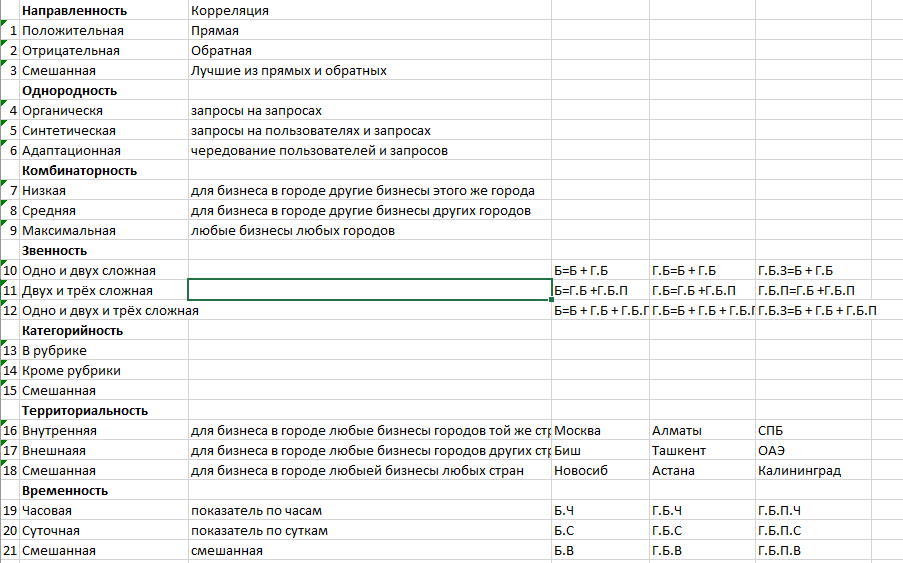